# Using Yelp Data to Recommend the Location of the Next Lou Malnati: Data Wrangling and EDA
Chicago pizza magnate Lou Malnati is looking to expand his national pizza empire. With 59 locations in Illinois, seven in Arizona, four in Wisconsin, and four in Indiana. Malnati is interested in potentially expanding both within Arizona and Indiana and to other states. In particular, Malnati is interested in Florida, Pennsylvania, New Jersey, and Missouri. 
Malnati’s restaurants are known for their deep dish pizza, and are looking for locations that either might not have deep dish options or locations where the pizza options are not satisfying consumers. Malnati's team believes that they can both introduce deep dish to new customers and lure currently unsatisfied customers with their nationally recognized pizza brand. 
Malnati’s team has requested an analysis of the existing landscape in the four new states along with Arizona and Indiana. They want to understand which state holds the most promise for more or more new locations. Ideally, they would like to open up multiple locations and want to know whether one of the new states would be a better option than continuing to open up restaurants in Arizona and Indiana.

**The purpose of this notebook is to clean and explore the business and review dataframes that were loaded and previewed in the 1-ridgway-read-data notebook.**

## Data Sources
All data has been downloaded directly from [Yelp](https://www.yelp.com/dataset):

1. yelp_academic_dataset_business.json: contains business data including location data, attributes, and categories
2. yelp_academic_dataset_review.json: contains full review text data including the user_id that wrote the review and the business_id the review is written for.

The data was loaded and read into pandas dataframes in the 1-ridgway-read-data notebook. The dataframes were filtered for only businesses with "pizza" in the categories and then pickled:

- business.pkl: pickled dataframe containing 7093 pizza businesses
- review.pkl: pickled dataframe containing 475,819 reviews for pizza businesses 

## Changes
- 03-10-22: Started project
- 03-14-22: Cleaned data
- 03-16-22: EDA
- 03-21-22: Added column for binary reviews rating
- 03-24-22: Further disaggregation by state, comment length
- 03-27-22: Added column for deep dish in comments, filtering for deep dish businesses for text analysis

## Summary of EDA

1. **Filtering:** The business dataset has been filtered to only include the six states being researched for the client. The total number of businesses has decreased from 7,093 to 5,314. The reviews dataset was also filtered, resulting in a decrease from 475,819 reviews to 346,149 reviews.
2. **Duplicates:** A check was conducted to see if there are any duplicate businesses, using the business_id column specifically. The same process was done using the reviews dataframe. Zero duplicates were found in both datasets.
3. **Missing Values:** For both datasets, there were only two columns that had any null values: the attributes and hours columns of the business_df. No businesses were dropped as those columns/features might not be needed for the analysis.
4. **Datatype Conversions:** For both datasets, there was only one column that required a datatype conversion: date in the reviews_df. The date column was originally a string and was converted to a datetime datatype.
5. **Outliers:** The numerical features for both datasets were reviewed to see if there are any outliers. For example, the maximum number of stars is 5; is_open is binary. No outliers were detected.
6. **Add Binary Rating:** To allow for sentiment analysis, the stars rating was converted to a binary. Ratings of 4 to 5 become 1 and ratings of less than 4 become 0.
7. **Drop Unnecessary Columns:** The user id, and columns for cool, funny, and useful are not needed in the analysis (review_id dataset). They were removed.
8. **Location Data:** Plotting the businesses for each state demonstrates that most businesses are clustered in specific parts of the state.
9. **Categorical Data (State/City/Postal Code):** The distribution of the dataset by state is not balanced. PA has the most businesses by far with 40%. Florida accounts for 20% of the businesses and Missouri, New Jersey, and Indian each account for ~10-13%. AZ has the least number of pizza businesses with 5%. The distribution of the dataset by city is also not balanced. A single city, Philadelphia, PA, accounts for 15% of the businesses. There are four cities that account for 4-7% of the businesses: Indianapolis, Tampa, Saint Louis, and Tucson. The rest of the cities represent fewer than 2% of the businesses. As expected, the number of businesses by postal code is at or less than 1% per code. The top two most frequent postal codes are located in Philadephia, PA.
10. **Categorical Data (Categories):** About 25% of the categories contain just "Pizza" and "Restaurant." Another 10% contain "Pizza," "Restaurant," and "Italian." Most of the top categories associated with pizza are general. However, there are few terms that indicate the restaurant serves other types of food, including sandwiches, chicken wings, and salad. Given that Lou Malnati also serves these items, it is worth exploring if particular cities or states also serve these items. Note that none of the categories include the terms "Deep" or "Dish." There is some variation in the percentage of pizza businesses serving Malnati sides by state. FL has the most with 40%; PA has the least with 30%. Notably, PA has the lowest percentage while having the highest number of businesses. There is also variation in percentage of businesses serving Malnati sides by city. Philadelphia, which has the most pizza businesses of any of the top 10 cities, has the lowest percetage of businesses serving Malnati sides. Note that there are 3 Lou Malnati restuarants in the dataset - none of which include any of the side categories.
11. **Categorical Data (Reviews and Reviewers):** The number of reviews varies by states. Of the 346,149, the majority are in PA and FL. The number of reviews varies by city as well. The vast majority are in Philadelphia, with similar numbers of reviews in Tucson, Indianapolis, Tampa, and Saint Louis. The number of unique reviewers is similar to the number of reviews when disaggregating by state. The only difference is that NJ and AZ are switched for second to least and least. The number of unique reviewers is similar to the number of reviews when disaggregating by city.
12. **Numerical Data (Star Ratings):** Star ratings appear to be quite consistent by state. NJ and FL have a slightly higher average rating (~3.4) compared to MO and AZ (~3.3).
13. **Numerical Data (Review Count):** There is much more variation in the average number of reviews by state. AZ has the highest average by far with ~106 reviews. MO and FL have around 70, PA and IN have around 60, and NJ has 38.
14. **Numerical Data (Open vs. Closed):** The percent of businesses open varies by state. AZ and NJ have 79% and 77% of their businesses open, which is above average. IN and PA are around the average of 71% and MO and FL (68% and 67%) are slightly below average. When considering the top 10 cities for number of businesses, there is also variation. Only one of the top-10 cities is above average (Tuscon), while 5 are 9% or more under the average. Of those five cities, three are in FL.
15. **Time Data:** Both the number of reviews and reviewers increased from 2005 to 2019. There was a sharp decline in 2020 and 2021; 2022 is much lower however this analysis is conducted in March of 2022. The percentage of businesses open declined from 2005 to 2008 and stayed relatively constantly through 2014. The percentage of businesses open has increased roughly 20-25% since 2018. The average rating declined from 2005 through 2009 where it stayed relatively consistent through 2016. There was a slight increase in 2017 with the average star rating staying relatively consistent since then.
16. **Text Data:** The review comments were processed by removing punctuation, lowering the case, tokenizing the sentences into single words, and eliminating stop words. The resulting comments were then stemmed and lemmitized separately with the most common words plotted in a bar graph: pizza, order, good, place, food, great.
17. **Deep Dish Businesses:** Reviews were categorized by mentioning deepdish or not. Each state has pizza businesses that have comments about their deep dish pizza. IN, MO, and FL all have at least 1000 reviews while AZ, PA, and NJ all have fewer than 500. However, while PA has fewer reviews, they have far more businesses who have deep dish reviews. When considering the density of businesses that have reviews about their deep dish pizza, IN and AZ have the highest percentage. PA and NJ have the lowest percentages. For all states, the percentage of reviews about deep dish pizza that makes up the total number of reviews is small. However, the reviews that are about deep dish are always more positive. This is especially true in AZ, MO, and IN, where the deep dish reviews are at least a quarter-point more positive.

## Import Libraries

In [1]:
# Libraries for data manipulation and graphing
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from wordcloud import WordCloud

# Libraries for mapping
import geopandas as gpd
from shapely.geometry import Point, Polygon
import matplotlib.pyplot as plt
import glob
from pathlib import Path

# Libraries for NLP pre-processing
import nltk
#nltk.download()
import string
from nltk import word_tokenize
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer
#nltk.download('wordnet')
from nltk import pos_tag
from nltk import pos_tag_sents
#nltk.download('averaged_perceptron_tagger')
from nltk.corpus import wordnet
from nltk.probability import FreqDist

## File Locations

In [2]:
business_pkl_df = '../data/interim/business.pkl'
review_pkl_df = '../data/interim/review.pkl'

processed_df = '../data/processed/processed.pkl'

## Load Data

In [3]:
business_df = pd.read_pickle(business_pkl_df)
reviews_df = pd.read_pickle(review_pkl_df)

## Clean Data

Cleaning the data includes:
- Filter by specific states: Arizona, Indiana, Florida, Pennslyvania, New Jersey, and Missouri.
- Checking for duplicate businesses
- Checking for missing values
- Converting data types
- Check for outliers in numerical features
- Add a column that changes the star ratings into a good/bad binary: 5 and 4 become 1; 3, 2, and 1 become 0

### Filtering for Specific States

In [4]:
# Filter and confirm that only the six desired states are included
states_list = ['AZ', 'IN', 'FL', 'PA', 'NJ', 'MO']

business_df = business_df[business_df['state'].isin(states_list)]

print('States included in the business df include:', business_df['state'].unique())

States included in the business df include: ['PA' 'FL' 'AZ' 'IN' 'MO' 'NJ']


In [5]:
# Determine the number of businesses remaining after the filter
business_df.shape[0]

5314

In [6]:
# Filter the review df 
business_ids = list(business_df['business_id'].unique())
reviews_df = reviews_df[reviews_df['business_id'].isin(business_ids)]

In [7]:
# Determine the number of reviews remaining after the filter
reviews_df.shape[0]

346149

<div class="alert alert-block alert-info">
The business dataset has been filtered to only include the six states being researched for the client. The total number of <b>businesses has decreased from 7,093 to 5,314</b>. The reviews dataset was also filtered, resulting in a decrease from <b>475,819 reviews to 346,149 reviews.</b>
</div>

### Checking for Duplicates

In [8]:
# Check for duplicate businesses by business_id
business_df[business_df.duplicated(subset=['business_id']) == True]

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours


In [9]:
# Check for duplicate reviews by review_id
reviews_df[reviews_df.duplicated(subset=['review_id']) == True]

,review_id,user_id,business_id,stars,useful,funny,cool,text,date


<div class="alert alert-block alert-info">
A check was conducted to see if there are any duplicate businesses, using the business_id column specifically. The same process was done using the reviews dataframe. <b>Zero duplicates were found in both datasets.</b>
</div>

### Checking for Missing Data

In [10]:
# Count the number of null values in each column of the business dataframe
business_df.isnull().sum()

business_id       0
name              0
address           0
city              0
state             0
postal_code       0
latitude          0
longitude         0
stars             0
review_count      0
is_open           0
attributes       61
categories        0
hours           770
dtype: int64

In [11]:
# Count the number of null values in each column of the reviews dataframe
reviews_df.isnull().sum()

review_id      0
user_id        0
business_id    0
stars          0
useful         0
funny          0
cool           0
text           0
date           0
dtype: int64

<div class="alert alert-block alert-info">
For both datasets, there were only two columns that had any null values: the attributes and hours columns of the business_df. <b>No businesses were dropped as those columns/features might not be needed for the analysis.</b>
</div>

### Convert Datatypes

In [12]:
business_df.head(3)

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
31,Mjboz24M9NlBeiOJKLEd_Q,DeSandro on Main,4105 Main St,Philadelphia,PA,19127,40.022466,-75.218314,3.0,41,0,"{'RestaurantsReservations': 'False', 'Caters':...","Pizza, Restaurants, Salad, Soup","{'Tuesday': '17:0-21:30', 'Wednesday': '17:0-1..."
33,kV_Q1oqis8Qli8dUoGpTyQ,Ardmore Pizza,10 Rittenhouse Pl,Ardmore,PA,19003,40.006707,-75.289671,3.5,109,1,"{'RestaurantsGoodForGroups': 'True', 'WiFi': '...","Pizza, Restaurants","{'Monday': '11:0-0:0', 'Tuesday': '11:0-0:0', ..."
59,JgpnXv_0XhV3SfbfB50nxw,Joe's Pizza,2038 N Dale Mabry Hwy,Tampa,FL,33607,27.960514,-82.506127,4.0,35,0,"{'BusinessParking': '{'garage': False, 'street...","Restaurants, Pizza","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'..."


In [13]:
# Check the datatypes of the business dataset
business_df.dtypes

business_id      object
name             object
address          object
city             object
state            object
postal_code      object
latitude        float64
longitude       float64
stars           float64
review_count      int64
is_open           int64
attributes       object
categories       object
hours            object
dtype: object

In [14]:
reviews_df.head(3)

,review_id,user_id,business_id,stars,useful,funny,cool,text,date
12,XW_LfMv0fV21l9c6xQd_lw,9OAtfnWag-ajVxRbUTGIyg,lj-E32x9_FA7GmUrBGBEWg,4.0,0,0,0,Love going here for happy hour or dinner! Gre...,2014-06-27 22:44:01
13,8JFGBuHMoiNDyfcxuWNtrA,smOvOajNG0lS4Pq7d8g4JQ,RZtGWDLCAtuipwaZ-UfjmQ,4.0,0,0,0,Good food--loved the gnocchi with marinara\nth...,2009-10-14 19:57:14
21,ZVvhc3Go7v5I8XTiVoWmqQ,WBpQDAZymU0dhIqXcACGNw,ut6fi2W2YaipNOqvi7e0jw,3.0,0,0,0,"Upland is a brewery based out of Bloomington, ...",2014-11-12 14:12:20


In [15]:
# Check the datatypes of the business dataset
reviews_df.dtypes

review_id       object
user_id         object
business_id     object
stars          float64
useful           int64
funny            int64
cool             int64
text            object
date            object
dtype: object

In [16]:
# Convert the date column to datetime
reviews_df['date'] = pd.to_datetime(reviews_df['date'])

<div class="alert alert-block alert-info">
For both datasets, there was only one column that required a datatype conversion: date in the reviews_df. <b>The date column was originally a string and was converted to a datetime datatype.</b>
</div>

### Check for Outliers in Numerical Features

In [17]:
# Check the datatypes of the business dataset
business_df.describe()

,latitude,longitude,stars,review_count,is_open
count,5314.000000,5314.000000,5314.000000,5314.000000,5314.000000
mean,37.043885,-81.211451,3.364791,62.457659,0.712834
std,4.847417,8.654149,0.817315,111.474707,0.452482
min,27.613073,-111.126426,1.000000,5.000000,0.000000
25%,32.426985,-86.022881,3.000000,14.000000,0.000000
50%,39.869562,-75.572650,3.500000,28.000000,1.000000
75%,40.011498,-75.149166,4.000000,66.000000,1.000000
max,40.442610,-74.690700,5.000000,2893.000000,1.000000


In [18]:
# Check the datatypes of the reviews dataset
reviews_df.describe()

,stars,useful,funny,cool
count,346149.000000,346149.000000,346149.000000,346149.000000
mean,3.692289,0.917625,0.270239,0.394004
std,1.456332,2.335065,1.247980,1.733318
min,1.000000,0.000000,0.000000,0.000000
25%,3.000000,0.000000,0.000000,0.000000
50%,4.000000,0.000000,0.000000,0.000000
75%,5.000000,1.000000,0.000000,0.000000
max,5.000000,189.000000,227.000000,175.000000


<div class="alert alert-block alert-info">
The numerical features for both datasets were reviewed to see if there are any outliers. For example, the maximum number of stars is 5; is_open is binary. <b>No outliers were detected.</b>
</div>

### Add Column with Binary Stars Rating (reviews_df)

In [19]:
conditions = [
    (reviews_df['stars'] >= 4),
    (reviews_df['stars'] < 4)
]

values = [
    1,
    0
]

reviews_df['binary_rating'] = np.select(conditions, values, default=np.nan)

### Drop Unnecessary Columns (reviews_df)

In [20]:
# Drop the cool, funny, and useful columns
reviews_df = reviews_df[['review_id', 'business_id', 'user_id', 'stars', 'text', 'date', 'binary_rating']]

## Exploratory Data Analysis

Exploratory Data Analysis (EDA) includes:
1. **Location data:** maps to show businesses by state
2. **Categorical data:** distributions using bar charts (city, state, postal code, categories)
3. **Numerical data:** distributions using histograms and and boxplots (stars for both datasets, review counts, open/closed)
4. **Time data:** distributions using historgrams to show review counts by year
5. **Text data:** preparing data using tokenization, stemming, lemmatization, stop word removal then frequency analysis by state and top city

### Location Data
Maps downloaded from the [2020 US Census](https://www.census.gov/geographies/mapping-files/time-series/geo/cartographic-boundary.html). 

In [21]:
# Define a function for plotting the map
def plot_business_map(state):
    # Get the appropriate shp file
    path = Path(f'../maps/{state}/')
    extension = '.shp'
    shp_file = next(path.glob(f'*{extension}'))
    state_map = gpd.read_file(f'{shp_file}')
    
    # Filter the business_df 
    business_df_state = business_df[business_df['state'] == f'{state}']
    
    # Create a feature of the latitude and longtitude
    gdf = gpd.GeoDataFrame(business_df_state, 
                           geometry = gpd.points_from_xy(business_df_state['longitude'], business_df_state['latitude']))
    
    # Plot the map with data points
    fig, ax = plt.subplots(figsize=(10,10))
    state_map.plot(ax=ax, alpha=0.4,color='white', edgecolor='black')
    gdf.plot(color = 'blue', ax=ax, legend='True')
    plt.title(f'Pizza Business Locations - {state}', fontsize=15, fontweight='bold')
    
    plt.show()

In [22]:
# Define a function for plotting the map with zoom based on points (with color for open or closed)
def plot_business_map_zoom(state):
    # Get the appropriate shp file
    path = Path(f'../maps/{state}/')
    extension = '.shp'
    shp_file = next(path.glob(f'*{extension}'))
    state_map = gpd.read_file(f'{shp_file}')
    
    # Filter the business_df 
    business_df_state = business_df[business_df['state'] == f'{state}']
    
    # Create a feature of the latitude and longtitude
    gdf = gpd.GeoDataFrame(business_df_state, 
                           geometry = gpd.points_from_xy(business_df_state['longitude'], business_df_state['latitude']))
    
    # Plot the map with data points
    fig, ax = plt.subplots(figsize=(15,15))
    state_map.plot(ax=ax, alpha=0.4,color='white', edgecolor='black')
    gdf.plot(column='is_open', ax=ax, legend='True')
    plt.title(f'Pizza Business Locations - {state} (Zoomed) with Open (1) and Closed (0)', fontsize=15, fontweight='bold')
    
    # Zoom in to show the distribution better
    minx, miny, maxx, maxy = gdf.total_bounds
    ax.set_xlim(minx-0.5, maxx+0.5)
    ax.set_ylim(miny-0.5, maxy+0.5)
    
    plt.show()

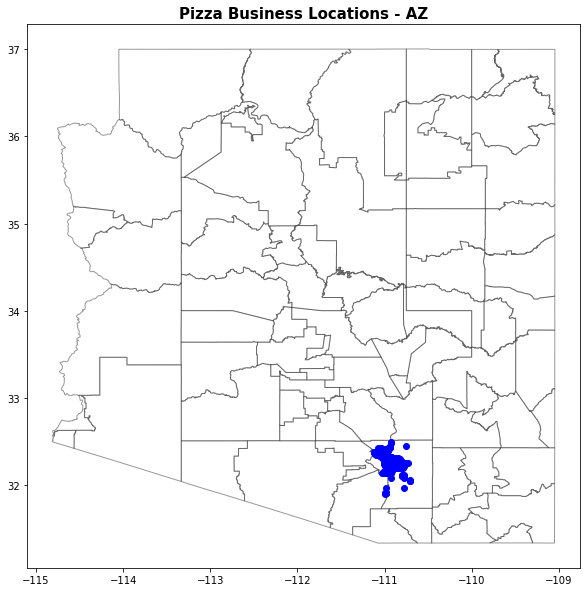

In [23]:
plot_business_map('AZ')

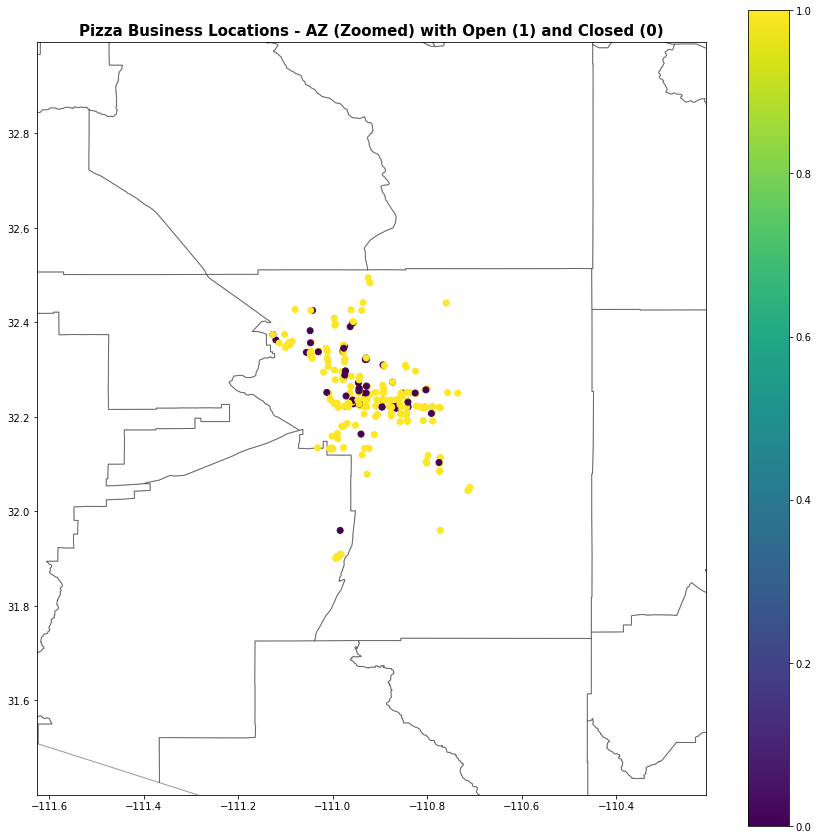

In [24]:
plot_business_map_zoom('AZ')

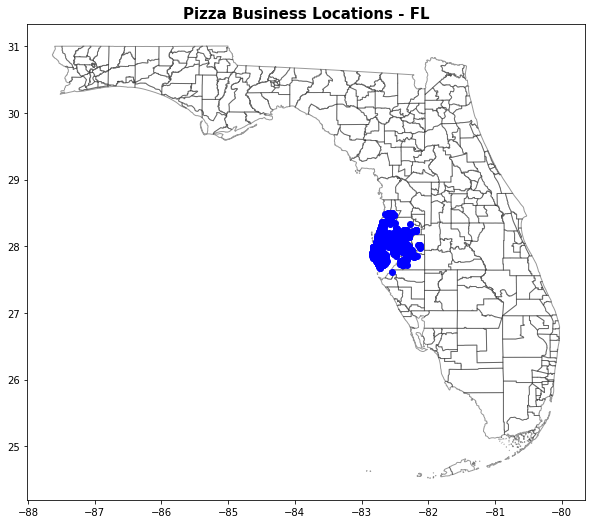

In [25]:
plot_business_map('FL')

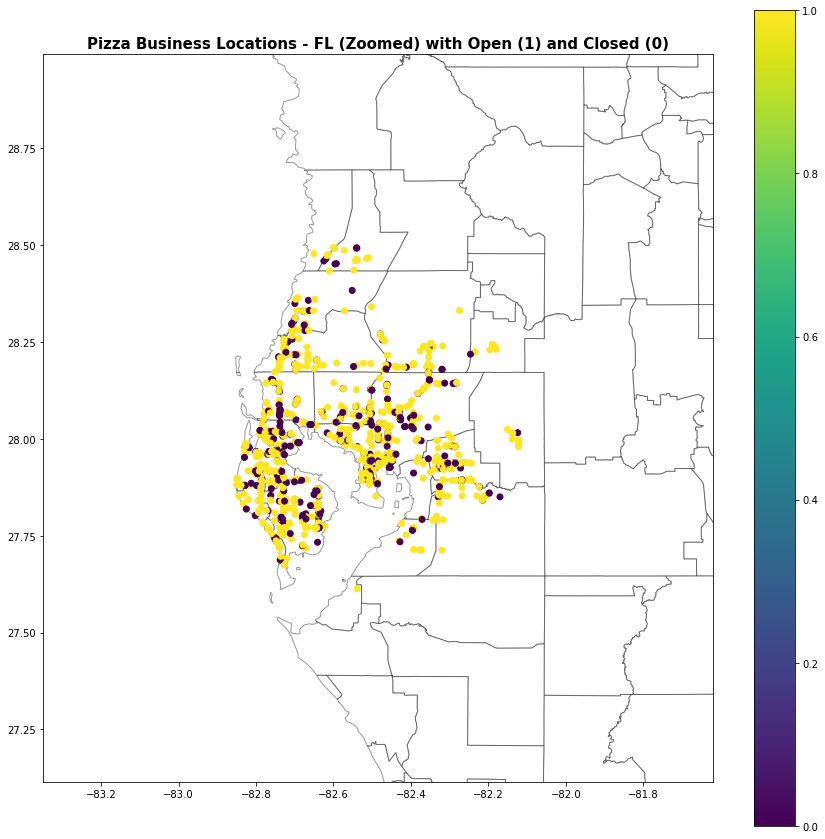

In [26]:
plot_business_map_zoom('FL')

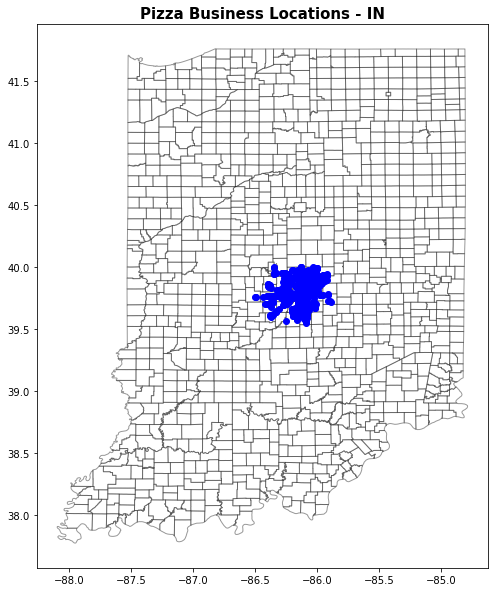

In [27]:
plot_business_map('IN')

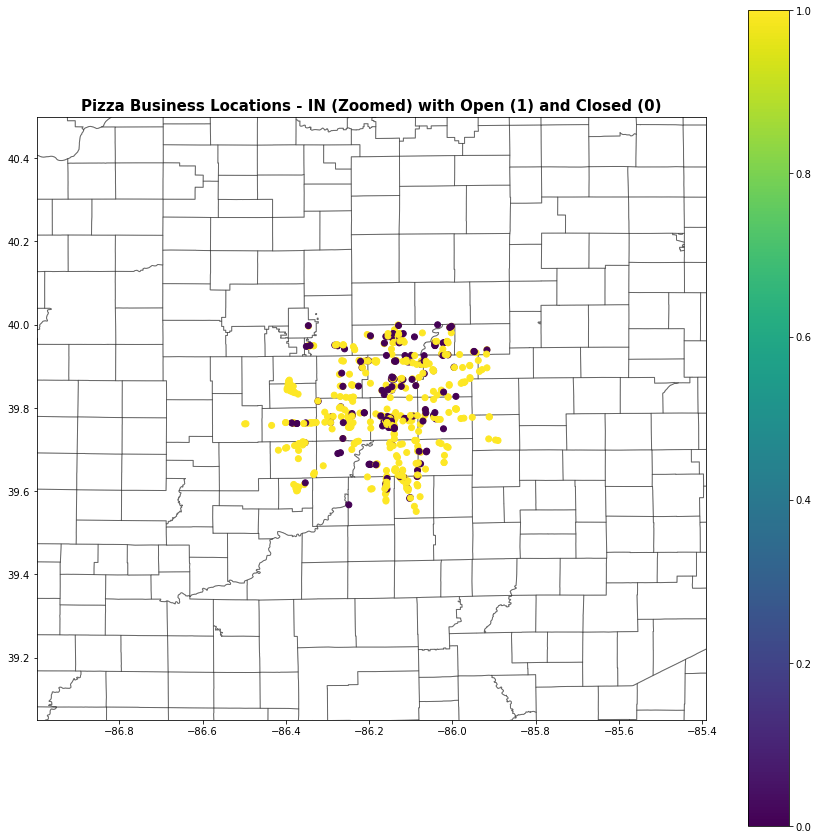

In [28]:
plot_business_map_zoom('IN')

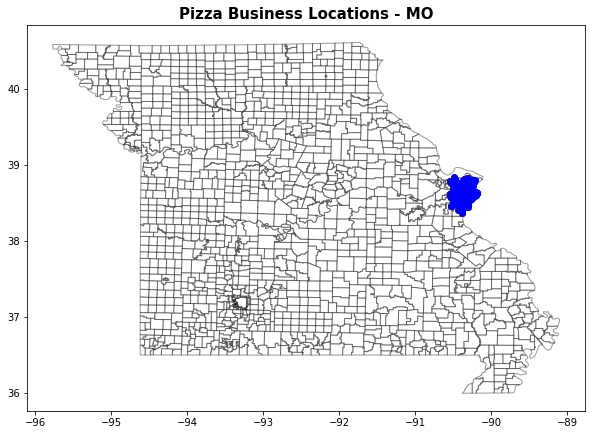

In [29]:
plot_business_map('MO')

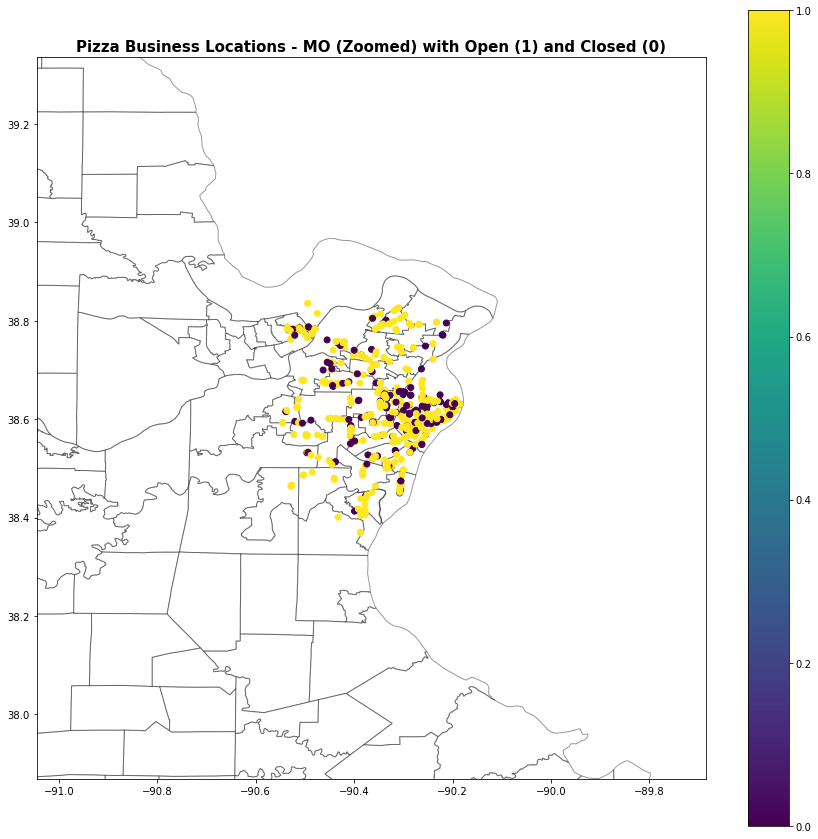

In [30]:
plot_business_map_zoom('MO')

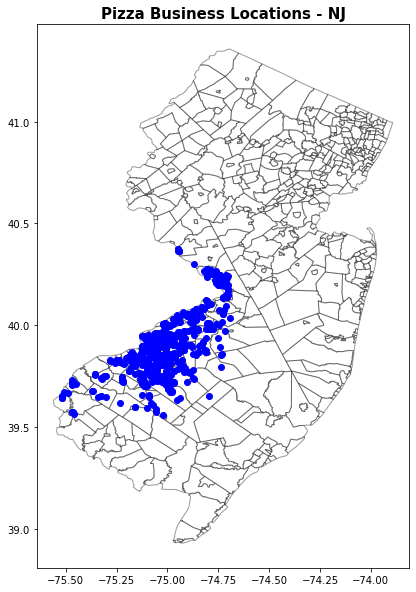

In [31]:
plot_business_map('NJ')

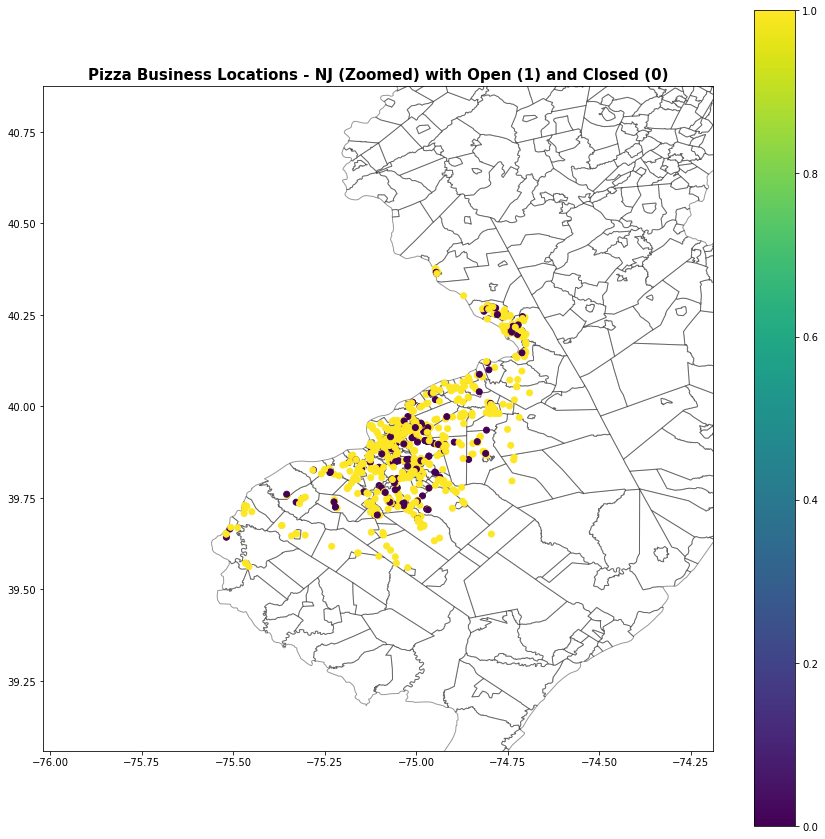

In [32]:
plot_business_map_zoom('NJ')

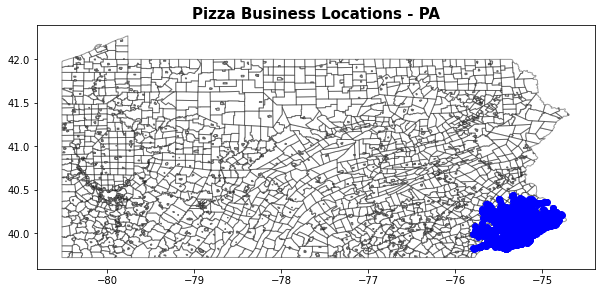

In [33]:
plot_business_map('PA')

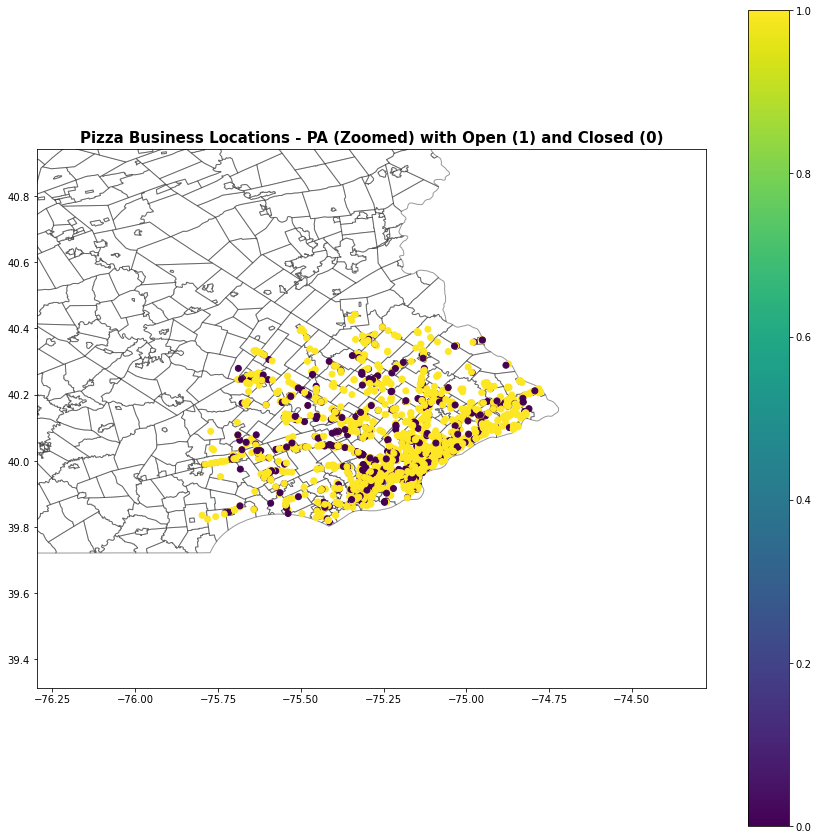

In [34]:
plot_business_map_zoom('PA')

<div class="alert alert-block alert-info">
Plotting the businesses for each state demonstrates that most businesses are clustered in specific parts of the state.
</div>

### Categorical Data

#### State, City, and Postal Code

In [35]:
# Create a dataframe of the counts by state
state_counts = pd.DataFrame(business_df['state'].value_counts()).reset_index().rename(columns={'index': 'State', 'state': 'Count'})

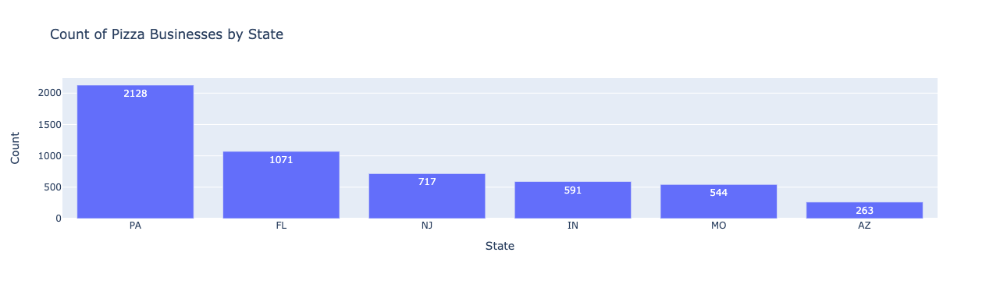

In [36]:
# Plot the count of states
fig = px.bar(state_counts, x='State', y='Count', text_auto=True, title='Count of Pizza Businesses by State')
fig.show()

In [37]:
# Identify the percentage of the total businesses by state
business_df['state'].value_counts(normalize=True)*100

PA    40.045164
FL    20.154309
NJ    13.492661
IN    11.121566
MO    10.237110
AZ     4.949191
Name: state, dtype: float64

<div class="alert alert-block alert-info">
    <b>The distribution of the dataset by state is not balanced.</b> PA has the most businesses by far with 40%. Florida accounts for 20% of the businesses and Missouri, New Jersey, and Indian each account for ~10-13%. AZ has the least number of pizza businesses with 5%.
</div>

In [38]:
# Add a column with city, state
business_df['city_state'] = business_df['city'] + ', ' + business_df['state']

In [39]:
# Create a dataframe of the counts by city with city/state pairing
city_counts = pd.DataFrame(business_df['city_state'].value_counts()).reset_index().rename(columns={'index': 'City', 'city_state': 'Count'})

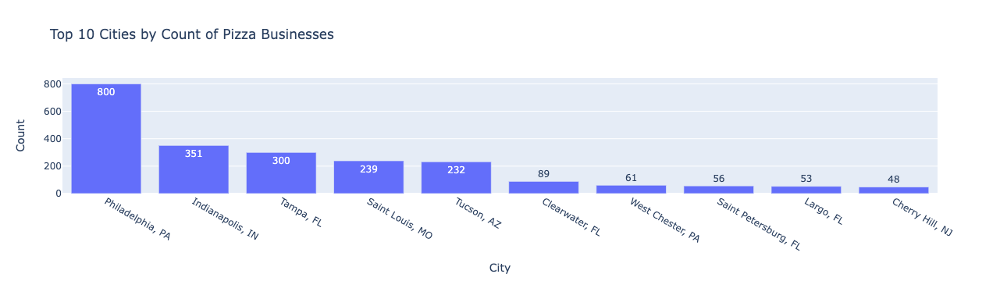

In [40]:
# Plot the count of the top 10 cities
fig = px.bar(city_counts.head(10), x='City', y='Count', text_auto=True, title='Top 10 Cities by Count of Pizza Businesses')
fig.show()

In [41]:
# Identify the percentage of the total businesses by city/state
business_df['city_state'].value_counts(normalize=True).head(10)*100

Philadelphia, PA        15.054573
Indianapolis, IN         6.605194
Tampa, FL                5.645465
Saint Louis, MO          4.497554
Tucson, AZ               4.365826
Clearwater, FL           1.674821
West Chester, PA         1.147911
Saint Petersburg, FL     1.053820
Largo, FL                0.997365
Cherry Hill, NJ          0.903274
Name: city_state, dtype: float64

<div class="alert alert-block alert-info">
    <b>The distribution of the dataset by city is also not balanced.</b> A single city, Philadelphia, PA, accounts for 15% of the businesses. There are four cities that account for 4-7% of the businesses: Indianapolis, Tampa, Saint Louis, and Tucson. The rest of the cities represent fewer than 2% of the businesses.
</div>

In [42]:
# Identify the percentage of the total businesses by postal code
business_df['postal_code'].value_counts(normalize=True).head(10)*100

19147    1.016184
19104    1.016184
19020    0.771547
46032    0.696274
19103    0.696274
19148    0.621001
33511    0.621001
46204    0.602183
19107    0.602183
46142    0.583365
Name: postal_code, dtype: float64

<div class="alert alert-block alert-info">
    As expected, the number of businesses by postal code is at or less than 1% per code. The top two most frequent postal codes are located in Philadephia, PA.
</div>

#### Categories

In [43]:
# Determine the number of unique category sets
unique_categories = business_df['categories'].nunique()
print('There are', unique_categories, 'unique sets of categories in the dataset')

There are 2576 unique sets of categories in the dataset


In [44]:
# Identify the top 20 category sets
pd.DataFrame(business_df['categories'].value_counts(normalize=True).head(20)*100)

,categories
"Restaurants, Pizza",13.624388
"Pizza, Restaurants",12.062476
"Italian, Restaurants, Pizza",1.994731
"Pizza, Restaurants, Italian",1.863003
"Restaurants, Italian, Pizza",1.750094
"Restaurants, Pizza, Italian",1.486639
"Italian, Pizza, Restaurants",1.430184
"Pizza, Italian, Restaurants",1.373730
"Pizza, Sandwiches, Restaurants",0.282273
"Sandwiches, Restaurants, Pizza",0.263455


In [45]:
# Identify the bottom 20 category sets
pd.DataFrame(business_df['categories'].value_counts(normalize=True).tail(20)*100)

,categories
"Buffets, Italian, Sandwiches, Chicken Wings, Pizza, Restaurants, Salad",0.018818
"Restaurants, Food, Pizza, Specialty Food, Pasta Shops, Italian",0.018818
"Nightlife, Sports Bars, Restaurants, Pizza, Chicken Wings, Bars",0.018818
"Restaurants, Italian, Beer, Wine & Spirits, Food, Pizza",0.018818
"Pizza, Food Delivery Services, Food, Restaurants, Barbeque",0.018818
"Pizza, American (Traditional), Sandwiches, Restaurants, Italian",0.018818
"Greek, Breakfast & Brunch, American (New), Restaurants, Italian, Pizza",0.018818
"Italian, Seafood, Sandwiches, Restaurants, Pizza",0.018818
"Nightlife, Bars, Pizza, Restaurants, Dive Bars, Seafood",0.018818
"Pizza, Restaurants, Cocktail Bars, Bars, Nightlife, Italian",0.018818


<div class="alert alert-block alert-info">
    About 25% of the categories contain just "Pizza" and "Restaurant." Another 10% contain "Pizza," "Restaurant," and "Italian." 
</div>

In [46]:
# Create a list of strings that contain the categories in each record
category_groups = list(business_df['categories'].explode())

In [47]:
# Convert category groups into a list of lists so that each category is now a single string
all_categories = []

for i in range(0,len(category_groups)):
    all_categories.append(category_groups[i].split(','))

In [48]:
# Flatten the list of lists in a single list of the categories
all_categories = [categories for sublist in all_categories for categories in sublist]

In [49]:
# Convert the list to a pandas df
all_categories_df = pd.DataFrame(all_categories, columns=['Categories'])

In [50]:
# Strip whitespace
all_categories_df['Categories'] = all_categories_df['Categories'].str.strip()

In [51]:
# Determine how many unique categories in the dataset
all_categories_df['Categories'].nunique()

303

In [52]:
# Determine the top 10 categories
category_counts = pd.DataFrame(all_categories_df['Categories'].value_counts()).reset_index().rename(columns={'index': 'Category', 
                                                                                                             'Categories': 'Count'})

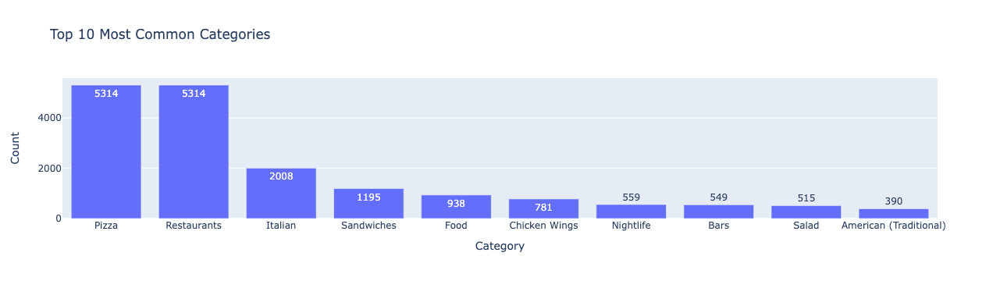

In [53]:
# Plot the top 10 categories
fig = px.bar(category_counts.head(10), x='Category', y='Count', text_auto=True, title = 'Top 10 Most Common Categories')
fig.show()

In [54]:
# Identify if 'Deep' or 'Dish' is a category
category_counts[category_counts['Category'].isin(['Deep', 'Dish'])]

,Category,Count


<div class="alert alert-block alert-info">
Most of the top categories associated with pizza are general. However, <b>there are few terms that indicate the restaurant serves other types of food, including sandwiches, chicken wings, and salad.</b> Note that none of the categories include the terms "Deep" or "Dish."
</div>

#### Reviews and Reviewers

In [55]:
# Identify the number of unique reviews
unique_reviews = reviews_df['review_id'].nunique()
print('There are', unique_reviews, 'unique reviews')

There are 346149 unique reviews


In [56]:
# Identify the number of unique reviewers
unique_reviewers = reviews_df['user_id'].nunique()
print('There are', unique_reviewers, 'unique reviewers')

There are 201411 unique reviewers


In [57]:
# Calculate the average number of reviews by user
avg_reviews_per_user = unique_reviews/unique_reviewers
print('The average number of reviews by user is:', round(avg_reviews_per_user))

The average number of reviews by user is: 2


In [58]:
# Add the state and city state to the reviews df
limited_business_df = business_df[['business_id', 'state', 'is_open', 'latitude', 'longitude', 'city_state']]
df = reviews_df.merge(limited_business_df, on='business_id')

In [59]:
# Calculate the number of reviews by state
reviews_count_state = df.groupby(['state'])['review_id'].count()
reviews_count_state = pd.DataFrame(reviews_count_state).reset_index().rename(columns={'state': 'State', 'review_id': 'Count'})
reviews_count_state = reviews_count_state.sort_values(by='Count', ascending = False)

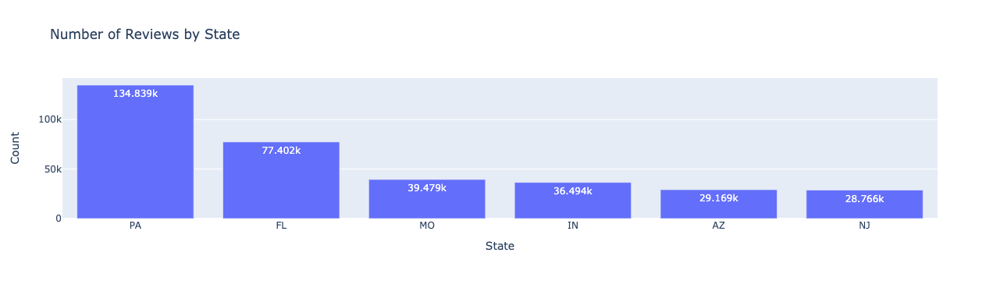

In [60]:
# Plot the number of reviews by state
fig = px.bar(reviews_count_state.head(10), x='State', y='Count', text_auto=True, 
             title = 'Number of Reviews by State')
fig.show()

<div class="alert alert-block alert-info">
The number of reviews varies by states. Of the 346,149, the majority are in PA and FL. 
</div>

In [61]:
# Calculate the number of reviews by city
reviews_count_city = df.groupby(['city_state'])['review_id'].count()
reviews_count_city = pd.DataFrame(reviews_count_city).reset_index().rename(columns={'city_state': 'City', 'review_id': 'Count'})
reviews_count_city = reviews_count_city.sort_values(by='Count', ascending = False)

In [62]:
# Filter the cities to only include the top 10 cities for pizza businesses
top_10_cities = list(city_counts['City'].head(10))
reviews_count_city = reviews_count_city[reviews_count_city['City'].isin(top_10_cities)]

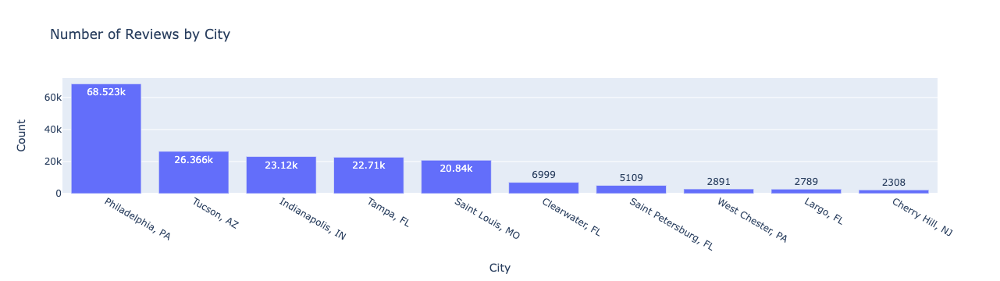

In [63]:
# Plot the number of reviews by city
fig = px.bar(reviews_count_city.head(10), x='City', y='Count', text_auto=True, 
             title = 'Number of Reviews by City')
fig.show()

<div class="alert alert-block alert-info">
The number of reviews varies by city as well. The vast majority are in Philadelphia, with similar numbers of reviews in Tucson, Indianapolis, Tampa, and Saint Louis.
</div>

In [64]:
# Calculate the number of reviewers by state
user_count_state = df.groupby(['state'])['user_id'].nunique()
user_count_state = pd.DataFrame(user_count_state).reset_index().rename(columns={'state': 'State', 'user_id': 'Count'})
user_count_state = user_count_state.sort_values(by='Count', ascending = False)

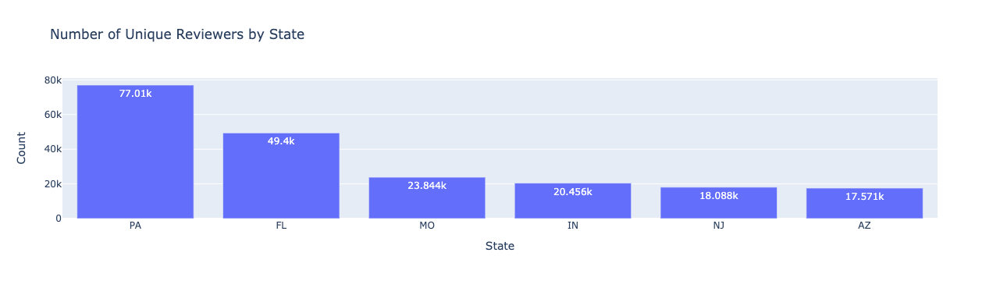

In [65]:
# Plot the number of reviewers by state
fig = px.bar(user_count_state.head(10), x='State', y='Count', text_auto=True, 
             title = 'Number of Unique Reviewers by State')
fig.show()

<div class="alert alert-block alert-info">
The number of unique reviewers is similar to the number of reviews when disaggregating by state. The only difference is that NJ and AZ are switched for second to least and least. 
</div>

In [66]:
# Calculate the number of reviewers by city
user_count_city = df.groupby(['city_state'])['user_id'].count()
user_count_city = pd.DataFrame(user_count_city).reset_index().rename(columns={'city_state': 'City', 'user_id': 'Count'})
user_count_city = user_count_city.sort_values(by='Count', ascending = False)

In [67]:
# Filter the cities to only include the top 10 cities for pizza businesses
user_count_city = user_count_city[user_count_city['City'].isin(top_10_cities)]

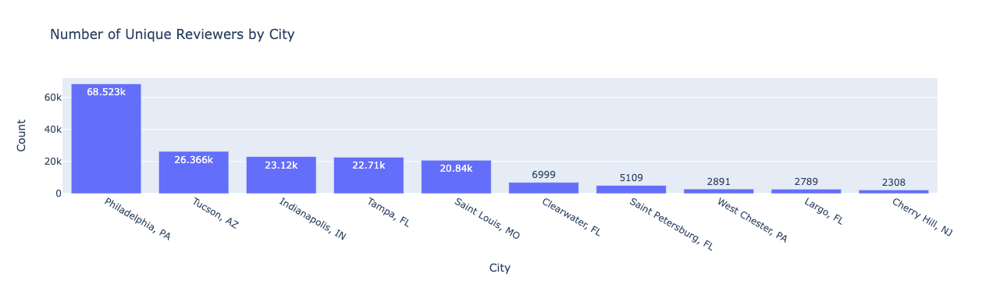

In [68]:
# Plot the number of reviewers by city
fig = px.bar(user_count_city.head(10), x='City', y='Count', text_auto=True, 
             title = 'Number of Unique Reviewers by City')
fig.show()

<div class="alert alert-block alert-info">
The number of unique reviewers is similar to the number of reviews when disaggregating by city.
</div>

### Numerical Data

#### Star Ratings

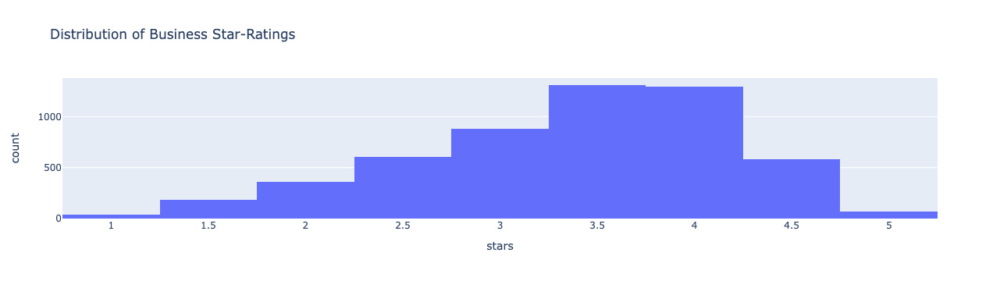

In [69]:
# Plot a histogram for the stars in the business_df
fig = px.histogram(business_df, x='stars', title='Distribution of Business Star-Ratings')
fig.show()

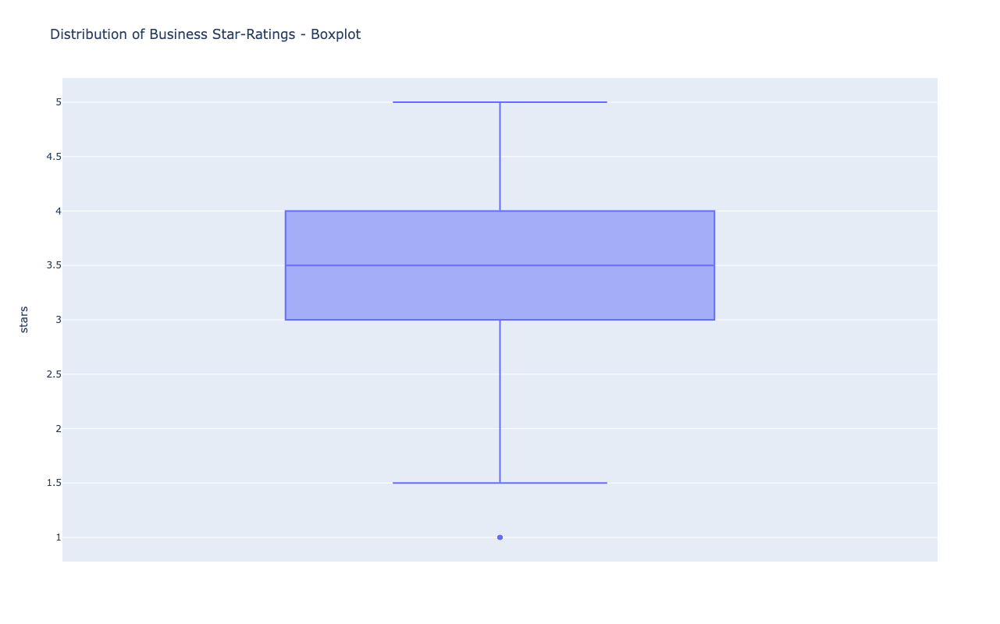

In [70]:
# Plot a boxplot for the stars in the business_df
fig = px.box(business_df, y='stars', title='Distribution of Business Star-Ratings - Boxplot', width=800, height=800)
fig.show()

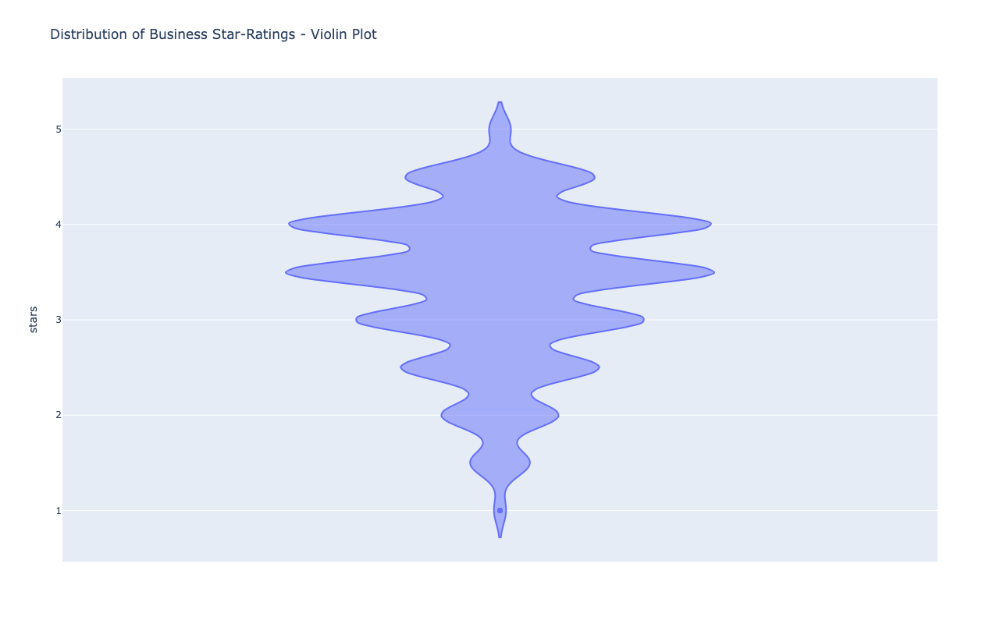

In [71]:
# Plot a violin for the stars in the business_df
fig = px.violin(business_df, y='stars', title='Distribution of Business Star-Ratings - Violin Plot', width=800, height=800)
fig.show()

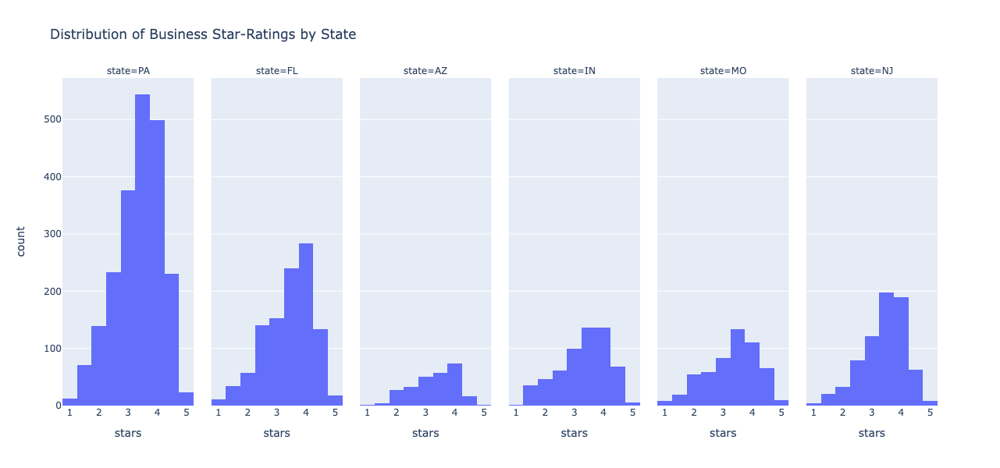

In [72]:
# Plot a histogram for the stars in the business_df by state
fig = px.histogram(business_df, x='stars', title='Distribution of Business Star-Ratings by State', facet_col = 'state', height = 600)
fig.show()

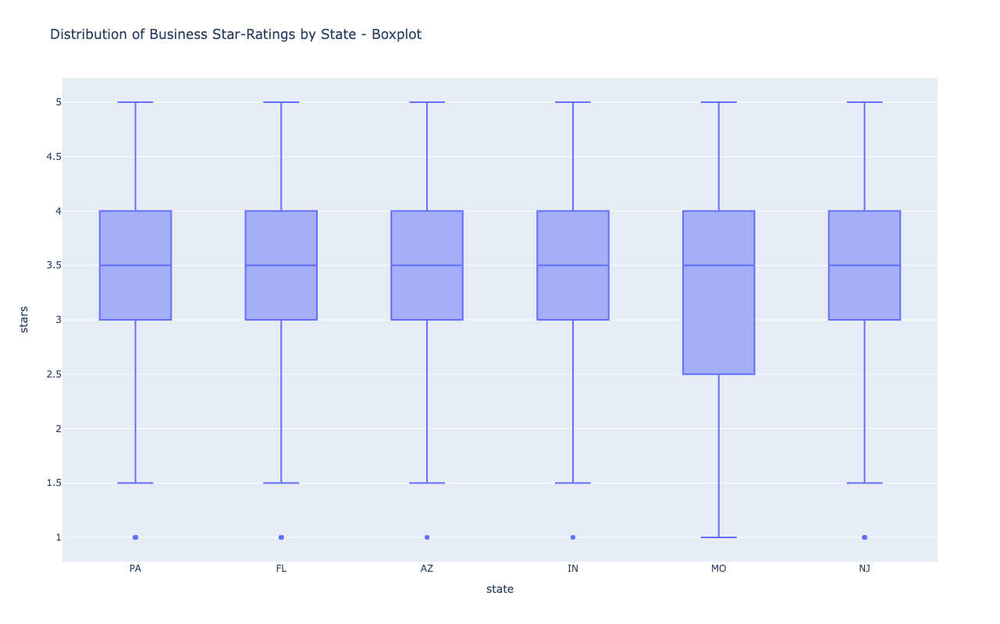

In [73]:
# Plot a boxplot for the stars in the business_df
fig = px.box(business_df, y='stars', x='state', title = 'Distribution of Business Star-Ratings by State - Boxplot', height = 800)
fig.show()

In [74]:
# Determine the average star rating by state
state_stars = business_df.groupby('state')['stars'].mean().sort_values(ascending=False).round(2)
state_stars = pd.DataFrame(state_stars).reset_index().rename(columns={'state': 'State', 'stars': 'Avg. Rating'})

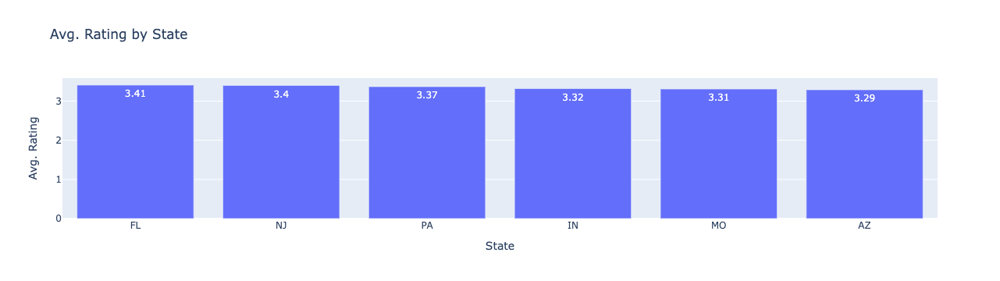

In [75]:
# Plot the avg. rating by state
fig = px.bar(state_stars, x='State', y='Avg. Rating', text_auto=True, title='Avg. Rating by State')
fig.show()

<div class="alert alert-block alert-info">
    <b>Star ratings appear to be quite consistent by state.</b> NJ and FL have a slightly higher average rating (~3.4) compared to MO and AZ (~3.3).
</div>

In [76]:
# Determine the average star rating by city
city_stars = business_df.groupby('city_state')['stars'].mean().sort_values(ascending=False).round(2)
city_stars = pd.DataFrame(city_stars).reset_index().rename(columns={'city_state': 'City', 'stars': 'Avg. Rating'})

In [77]:
# Filter the cities to only include the top 10 cities for pizza businesses
city_stars = city_stars[city_stars['City'].isin(top_10_cities)]

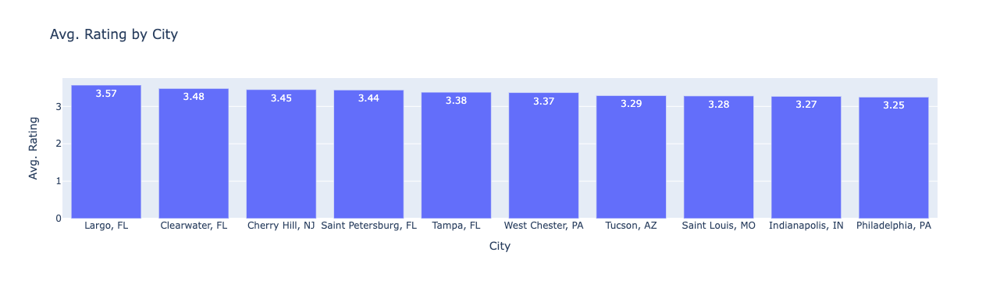

In [78]:
# Plot the avg. rating by state
fig = px.bar(city_stars, x='City', y='Avg. Rating', text_auto=True, title='Avg. Rating by City')
fig.show()

<div class="alert alert-block alert-info">
    <b>There is some variation when comparing the top ten cities by rating.</b> Three of the top five cities by rating are in Floria; Philly, which has the most number of reviews and pizza businesses, has the lowest rating in the top ten.
</div>

#### Review Count

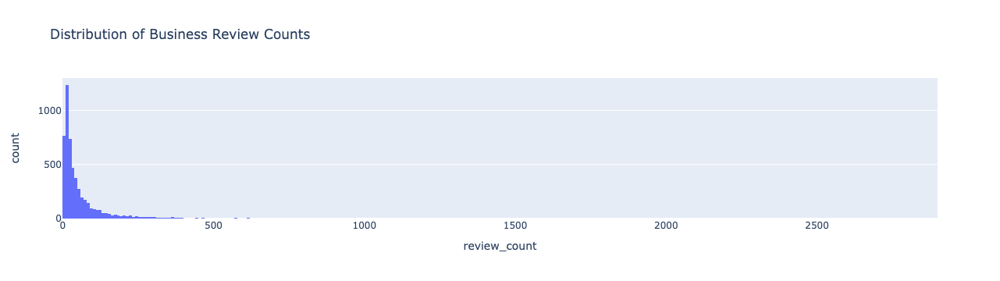

In [79]:
# Plot a histogram for the reviews in the business_df
fig = px.histogram(business_df, x='review_count', title='Distribution of Business Review Counts')
fig.show()

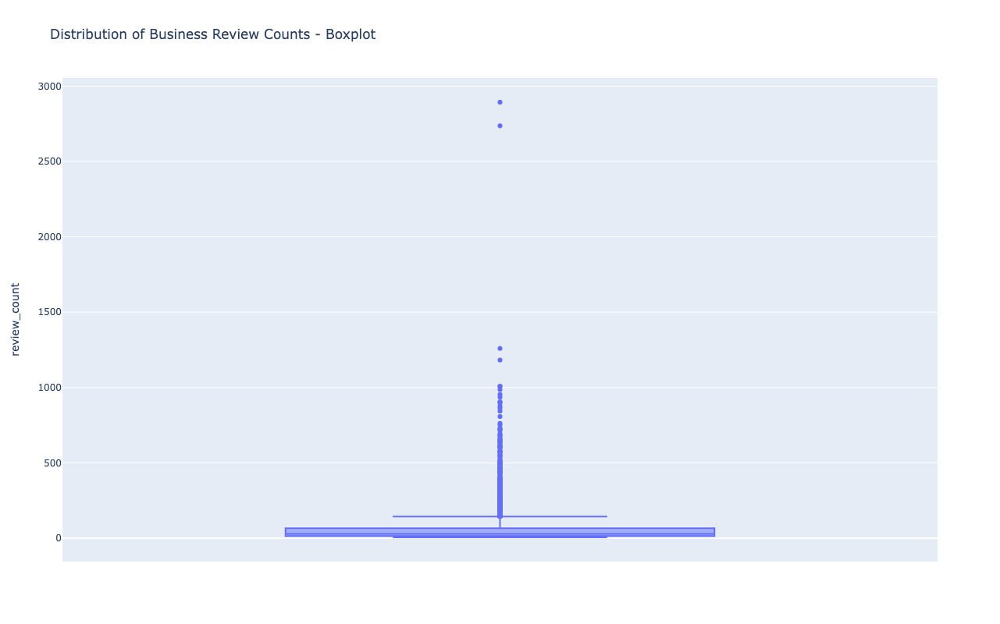

In [80]:
# Plot a boxplot for the stars in the business_df
fig = px.box(business_df, y='review_count',title='Distribution of Business Review Counts - Boxplot', height = 800, width = 800)
fig.show()

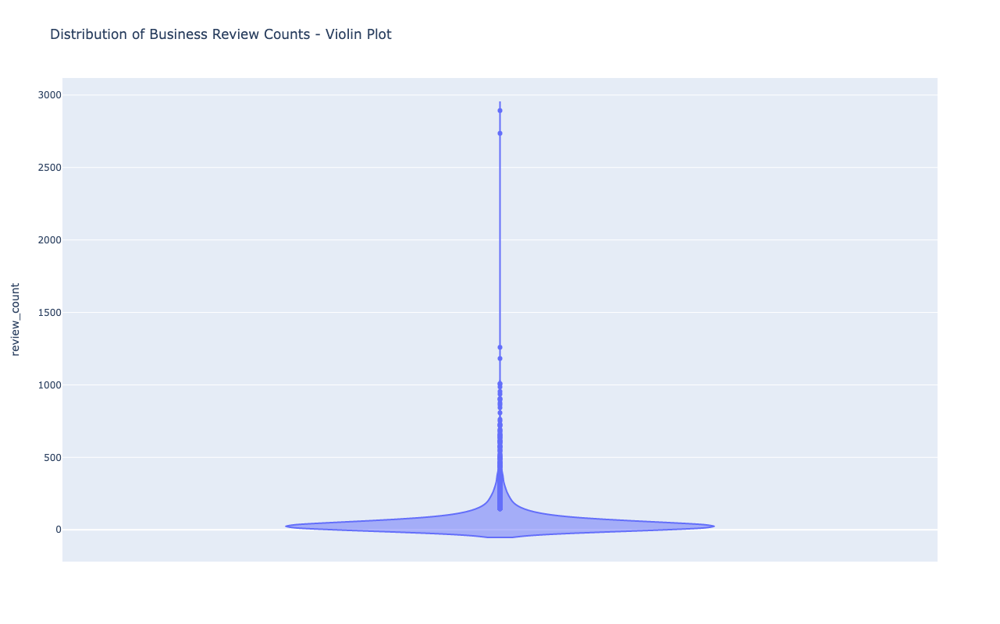

In [81]:
# Plot a violin for the stars in the business_df
fig = px.violin(business_df, y='review_count',title='Distribution of Business Review Counts - Violin Plot', height = 800, width = 800)
fig.show()

In [82]:
# Review which businesses have the highest review counts
business_df.sort_values(by='review_count', ascending=False).head(10)

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,city_state
64928,6ajnOk0GcY9xbb5Ocaw8Gw,Barbuzzo,110 S 13th St,Philadelphia,PA,19107,39.950007,-75.162158,4.5,2893,1,"{'WiFi': 'u'no'', 'Caters': 'False', 'Restaura...","Mediterranean, Restaurants, Pizza, Italian","{'Monday': '17:0-22:0', 'Tuesday': '17:0-22:0'...","Philadelphia, PA"
53452,sTPueJEwcRDj7ZJmG7okYA,Jim's South St,400 S St,Philadelphia,PA,19147,39.941498,-75.149272,3.5,2736,1,"{'BusinessParking': '{'garage': False, 'street...","Bars, Restaurants, Pizza, Cheesesteaks, Italia...","{'Monday': '0:0-0:0', 'Tuesday': '11:0-0:0', '...","Philadelphia, PA"
31684,0d1dpaZqcm7litFOJl7atA,Noble Crust,8300 4th St N,St. Petersburg,FL,33702,27.847898,-82.639001,4.5,1259,1,"{'RestaurantsPriceRange2': '2', 'RestaurantsTa...","Breakfast & Brunch, Pizza, Southern, Italian, ...","{'Monday': '16:0-22:0', 'Tuesday': '16:0-22:0'...","St. Petersburg, FL"
129031,Bxmhm659VqrQYHc0hiku5w,Eddie & Sam's NY Pizza,203 E Twiggs St,Tampa,FL,33602,27.948891,-82.459164,4.5,1182,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Salad, Food, Pizza, Restaurants, Desserts, Ice...","{'Wednesday': '11:0-22:0', 'Thursday': '11:0-2...","Tampa, FL"
123285,cmvseNCdevDdxbxlz3KkWw,Shrimpys Blues Bistro,"9524 Blind Pass Rd, Ste 22",St Pete Beach,FL,33706,27.755835,-82.759691,4.5,1008,1,"{'WiFi': 'u'no'', 'RestaurantsAttire': 'u'casu...","Bars, Restaurants, American (New), Pubs, Night...","{'Monday': '11:30-21:30', 'Tuesday': '15:0-22:...","St Pete Beach, FL"
54427,LGYIhGqbYakMMdsn_GCzJg,Anthonino's Taverna,2225 Macklind Ave,Saint Louis,MO,63110,38.614366,-90.277870,4.5,1007,1,"{'RestaurantsTakeOut': 'True', 'BusinessAccept...","Greek, Pizza, Restaurants, Italian, Mediterranean","{'Monday': '0:0-0:0', 'Tuesday': '11:0-22:0', ...","Saint Louis, MO"
36430,j8feOxyJqlIJWOi8su2qzw,Serial Grillers,5975 E Speedway Blvd,Tucson,AZ,85712,32.236675,-110.865028,4.5,986,1,"{'NoiseLevel': 'u'average'', 'WiFi': 'u'no'', ...","Cheesesteaks, Food, Salad, Restaurants, Sandwi...","{'Monday': '11:0-20:0', 'Tuesday': '11:0-20:0'...","Tucson, AZ"
66348,sVZb87xjhbCWHQ2UXOGLrA,Giorgio On Pine,1328 Pine St,Philadelphia,PA,19107,39.945339,-75.164454,4.0,954,1,"{'Alcohol': 'u'none'', 'WiFi': 'u'no'', 'Resta...","Pizza, Italian, Restaurants, Gluten-Free","{'Monday': '11:30-22:0', 'Tuesday': '11:30-22:...","Philadelphia, PA"
55156,_MWbuRiTqbWEjlfxRAvzWQ,Cristino's Coal Oven Pizza,1101 S Fort Harrison Ave,Clearwater,FL,33756,27.954326,-82.799617,4.5,936,1,"{'RestaurantsAttire': 'u'casual'', 'Restaurant...","Pizza, Restaurants","{'Monday': '11:0-21:30', 'Tuesday': '11:0-21:3...","Clearwater, FL"
123592,TNTBObKmICMn13T0pyAGyg,BellaBrava,204 Beach Dr NE,St. Petersburg,FL,33701,27.773743,-82.632966,4.0,904,1,"{'RestaurantsTakeOut': 'True', 'RestaurantsAtt...","Pizza, Bars, Italian, Nightlife, Restaurants","{'Monday': '11:30-22:0', 'Tuesday': '11:30-22:...","St. Petersburg, FL"


In [83]:
# Remove the businesses that have over 1000 reviews (top 6)
no_outliers = business_df[business_df['review_count'] < 1000]

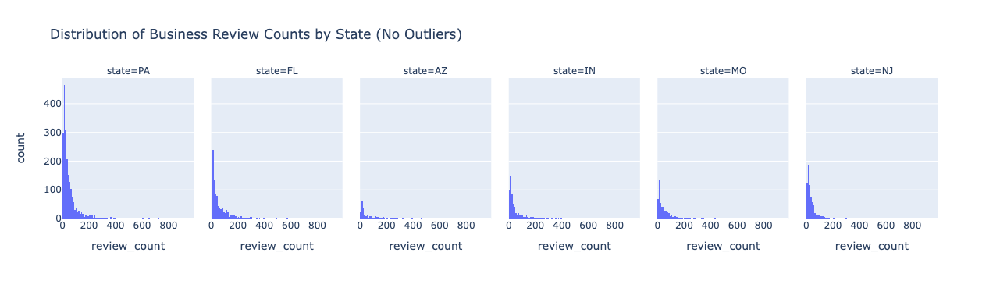

In [84]:
# Plot a histogram for the reviews in the business_df by state
fig = px.histogram(no_outliers, x='review_count', title='Distribution of Business Review Counts by State (No Outliers)', facet_col = 'state')
fig.show()

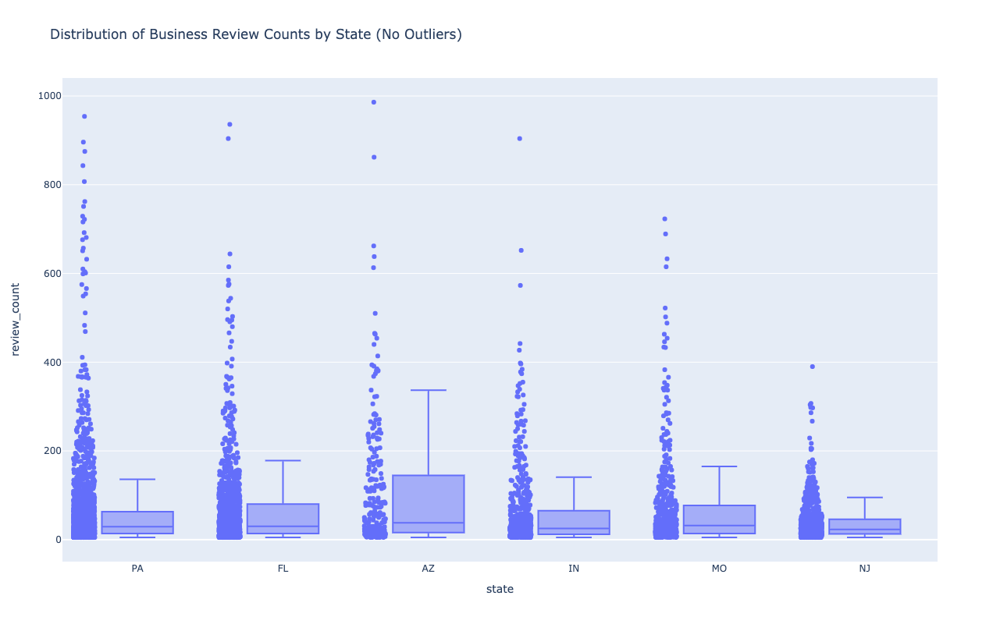

In [85]:
# Plot a boxplot for the reviews in the business_df
fig = px.box(no_outliers, y='review_count', x = 'state', title='Distribution of Business Review Counts by State (No Outliers)', points='all',
            height = 800)
fig.show()

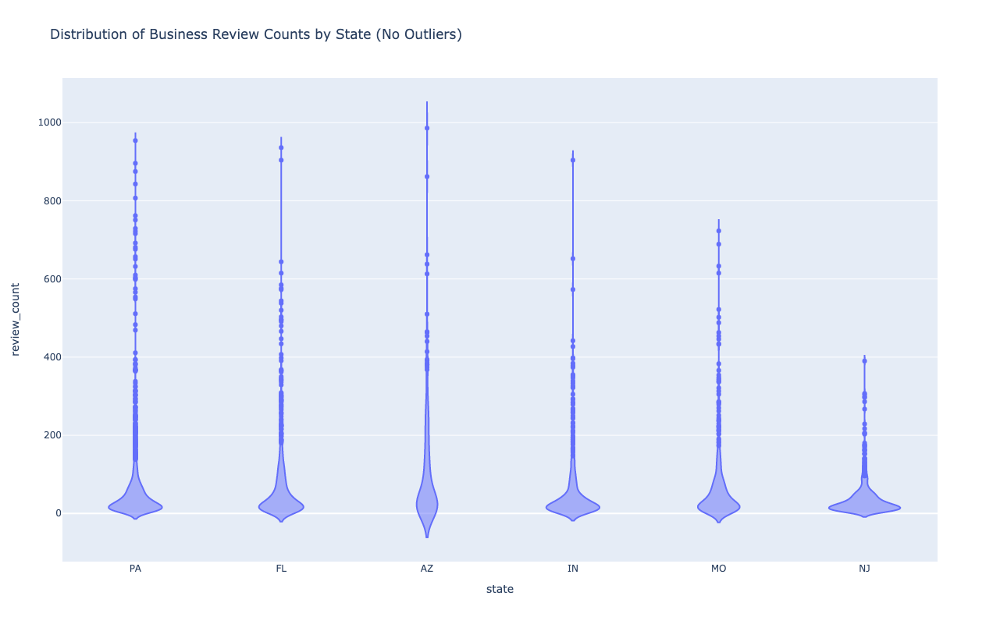

In [86]:
# Plot a violin for the reviews in the business_df
fig = px.violin(no_outliers, y='review_count', x = 'state', title='Distribution of Business Review Counts by State (No Outliers)',
               height = 800)
fig.show()

In [87]:
# Determine the average number of reviews by state
state_reviews = business_df.groupby('state')['review_count'].mean().sort_values(ascending=False).round(0)
state_reviews = pd.DataFrame(state_reviews).reset_index().rename(columns={'state': 'State', 'review_count': 'Avg. Number of Reviews'})

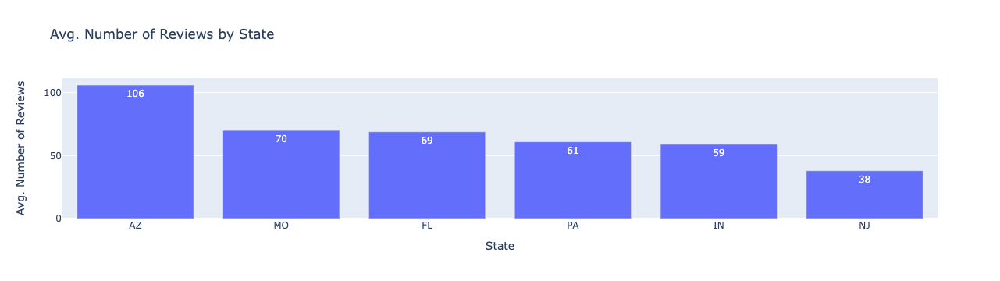

In [88]:
# Plot the avgerage number of reviews by state
fig = px.bar(state_reviews, x='State', y='Avg. Number of Reviews', text_auto=True, title='Avg. Number of Reviews by State')
fig.show()

<div class="alert alert-block alert-info">
    <b>There is much more variation in the average number of reviews by state.</b> AZ has the highest average by far with ~106 reviews. MO and FL have around 70, PA and IN have around 60, and NJ has 38. 
</div>

#### Open vs. Closed

In [89]:
# Identify how many businesses are open and closed
status = pd.DataFrame(business_df['is_open'].value_counts().reset_index().rename(columns={'index': 'Status', 'is_open': 'Count'}))
status['Status'] = status['Status'].replace({1:'Open', 0:'Closed'})

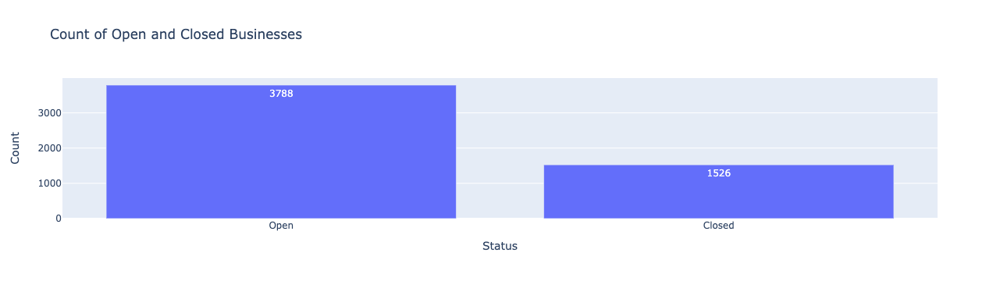

In [90]:
# Plot the number of open vs. closed
fig = px.bar(status, x='Status', y='Count', title='Count of Open and Closed Businesses', text_auto = True)
fig.show()

In [91]:
# Calculate percentage of open vs. closed
round(business_df['is_open'].value_counts(normalize=True)*100)

1    71.0
0    29.0
Name: is_open, dtype: float64

In [92]:
# Identify the percentage of businesses in each state that are open
status_state = round(business_df.groupby(['state'])['is_open'].sum()/business_df.groupby(['state'])['business_id'].count()*100)
status_state = pd.DataFrame(status_state).reset_index().rename(columns={'state': 'State', 0: 'Percentage of Businesses'})
status_state = status_state.sort_values(by='Percentage of Businesses', ascending = False)

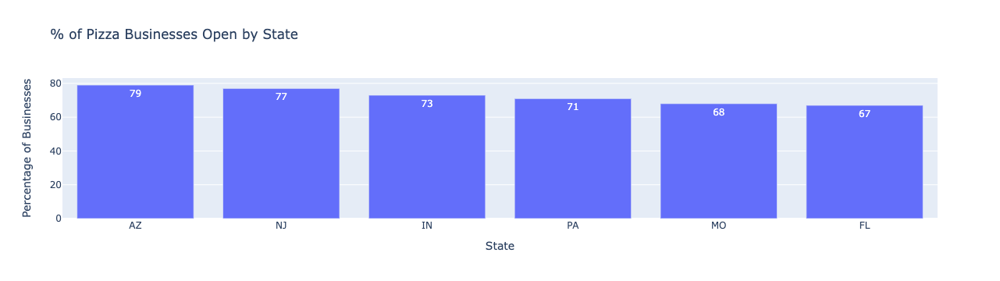

In [93]:
# Plot the % of businesses that are open
fig = px.bar(status_state.head(10), x='State', y='Percentage of Businesses', text_auto=True, 
             title = '% of Pizza Businesses Open by State')
fig.show()

<div class="alert alert-block alert-info">
    <b>The percent of businesses open varies by state.</b> AZ and NJ have 79% and 77% of their businesses open, which is above average. IN and PA are around the average of 71% and MO and FL (68% and 67%) are slightly below average.
</div>

In [94]:
# Identify the percentage of businesses in each city that are open
status_city = round(business_df.groupby(['city_state'])['is_open'].sum()/business_df.groupby(['city_state'])['business_id'].count()*100)
status_city = pd.DataFrame(status_city).reset_index().rename(columns={'city_state': 'City', 0: 'Percentage of Businesses'})
status_city = status_city.sort_values(by='Percentage of Businesses', ascending = False)

In [95]:
# Filter the cities to only include the top 10 cities for pizza businesses
status_city = status_city[status_city['City'].isin(top_10_cities)]

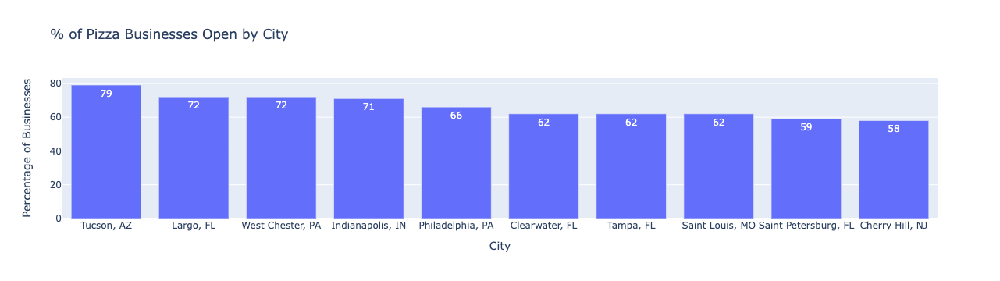

In [96]:
# Plot the % of businesses that serve Malnati sides by city
fig = px.bar(status_city.head(10), x='City', y='Percentage of Businesses', text_auto=True, 
             title = '% of Pizza Businesses Open by City')
fig.show()

<div class="alert alert-block alert-info">
When considering the top 10 cities for number of businesses, there is also variation. Only one of the top-10 cities is above average (Tuscon), while 5 are 9% or more under the average. Of those five cities, three are in FL.
</div>

### Time Data

#### Reviews and Reviewers by Year

In [97]:
# Add a column to the merged dataset that includes year
df['year'] = df['date'].dt.year

In [98]:
# Identify the number of unique reviews and reviewers by year
reviews_year = pd.DataFrame(df.groupby([df['year']]).nunique())
reviews_year = reviews_year.reset_index()

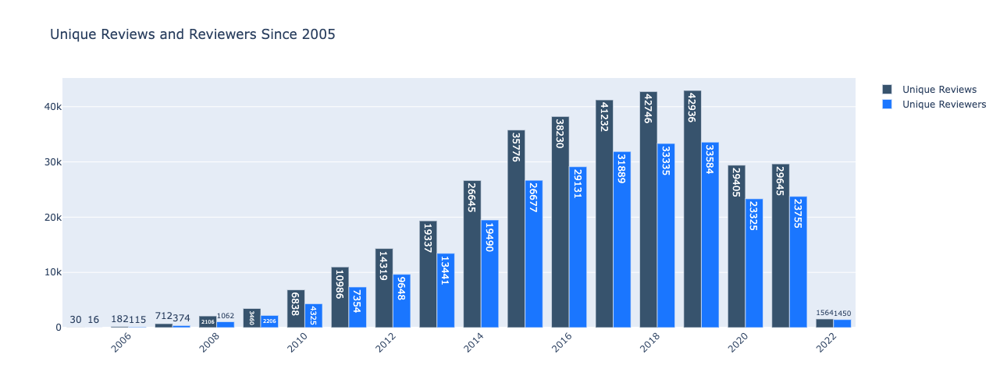

In [99]:
# Plot the count of unique reviewers and reviews
fig = go.Figure(data=[
    go.Bar(name='Unique Reviews', 
           x=reviews_year['year'], 
           y=reviews_year['review_id'], 
           text=reviews_year['review_id'], 
           textposition='auto',
          marker_color='rgb(55, 83, 109)'),
    
    go.Bar(name='Unique Reviewers', 
           x=reviews_year['year'], 
           y=reviews_year['user_id'], 
           text=reviews_year['user_id'], 
           textposition='auto',
          marker_color='rgb(26, 118, 255)')
])

fig.update_layout(barmode='group', 
                  title_text = 'Unique Reviews and Reviewers Since 2005',
                 xaxis_tickangle=-45,
                 autosize = False,
                  height = 500,
                 width = 1400)
fig.show()

<div class="alert alert-block alert-info">
    Both the number of reviews and reviewers increased from 2005 to 2019. There was a sharp decline in 2020 and 2021; 2022 is much lower however this analysis is conducted in March of 2022.
</div>

In [100]:
# Define a function to plots the reviews and reviewers for each state over time 
def state_reviews_overtime(state):
    # Filter the reviews_df for the specific state
    df_state = df[df['state'] == state]
    
    # Identify the number of unique reviews and reviewers by year
    reviews_per_year = pd.DataFrame(df_state.groupby([df_state['year']]).nunique())
    reviews_per_year = reviews_per_year.reset_index()
    
    # Plot the count of unique reviewers and reviews
    fig = go.Figure(data=[
        go.Bar(name='Unique Reviews', 
               x=reviews_per_year['year'], 
               y=reviews_per_year['review_id'], 
               text=reviews_per_year['review_id'], 
               textposition='auto',
               marker_color='rgb(55, 83, 109)'),

        go.Bar(name='Unique Reviewers', 
               x=reviews_per_year['year'], 
               y=reviews_per_year['user_id'], 
               text=reviews_per_year['user_id'], 
               textposition='auto',
               marker_color='rgb(26, 118, 255)')
    ])

    fig.update_layout(barmode='group', 
                      title_text = f'Historical Count of Unique Reviews and Reviewers in {state}',
                      xaxis_tickangle=-45,
                      autosize = False,
                      height = 500,
                      width = 1400)
    fig.show()


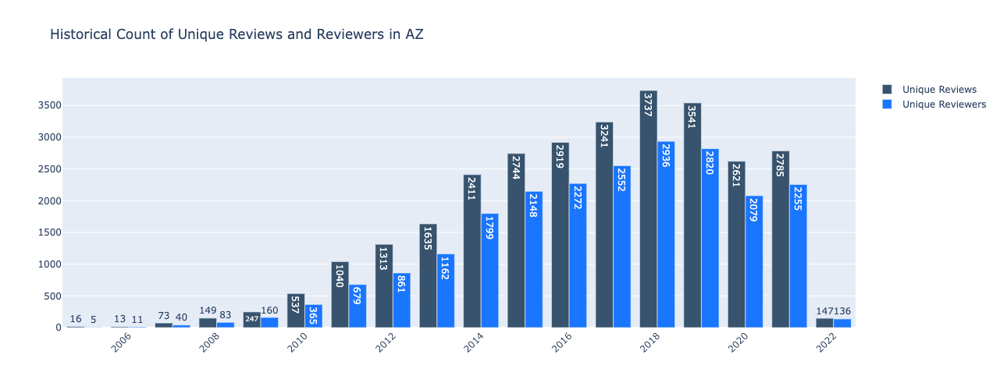

In [101]:
state_reviews_overtime('AZ')

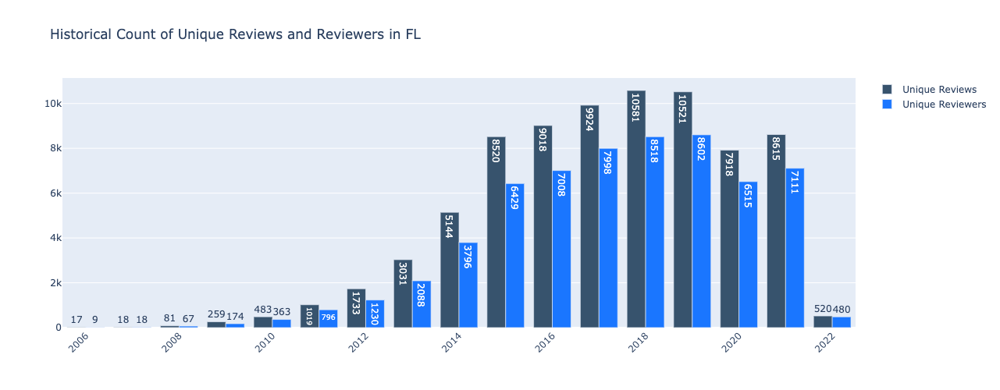

In [102]:
state_reviews_overtime('FL')

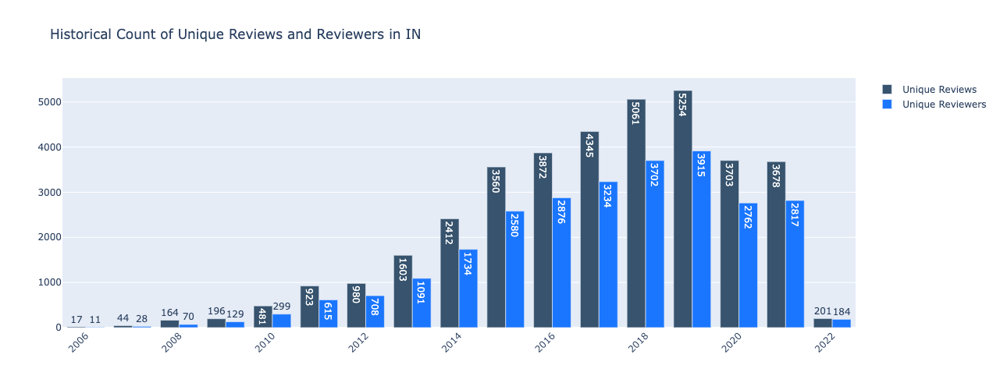

In [103]:
state_reviews_overtime('IN')

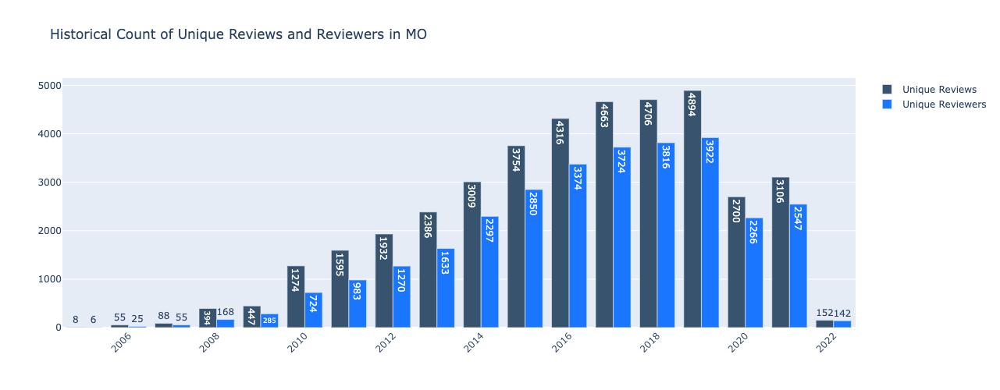

In [104]:
state_reviews_overtime('MO')

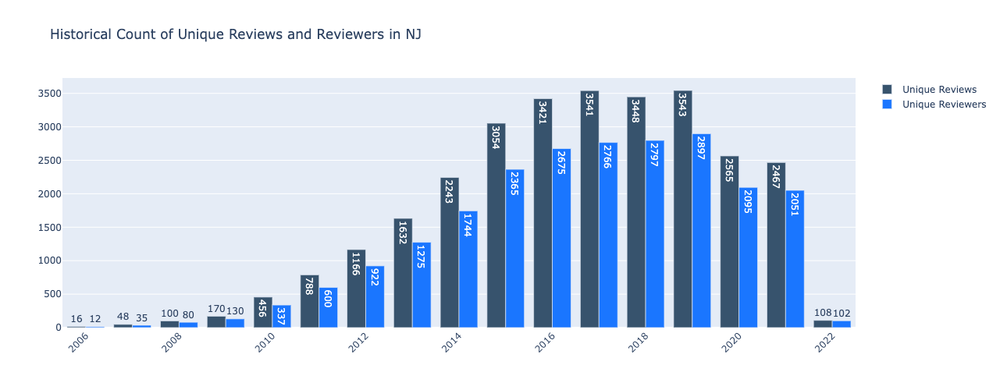

In [105]:
state_reviews_overtime('NJ')

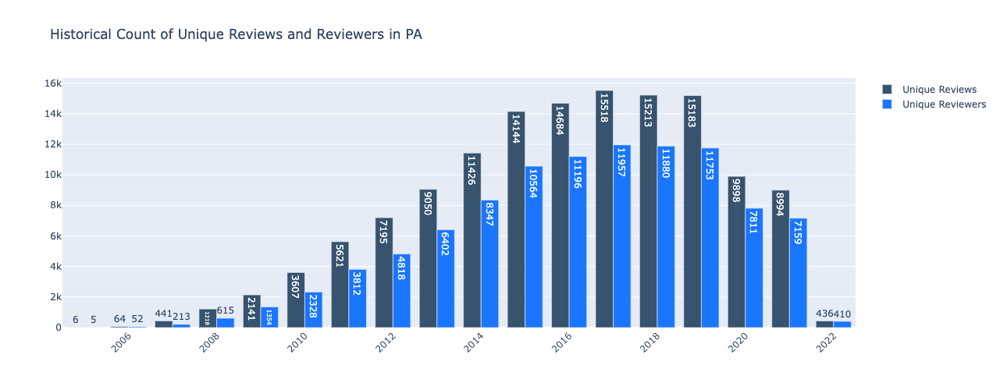

In [106]:
state_reviews_overtime('PA')

<div class="alert alert-block alert-info">
    The number of reviews and reviewers over time tends to look quite similar between states, with the exception of the last couple years. While all states saw a dramatic reduction in reviews from 2019 to 2020 (likely due to COVID-19), only MO, FL, and AZ saw an rebound (slight) from 2020 to 2021.
</div>

#### Businesses Open by Year

In [107]:
# Create a dataframe of the percentage of businesses open each year
open_year = pd.DataFrame((df.groupby('year')['is_open'].sum()/df.groupby('year')['is_open'].count()).round(2)*100)
open_year = open_year.reset_index().rename(columns={'year': 'Year', 'is_open': 'Percent Open'})

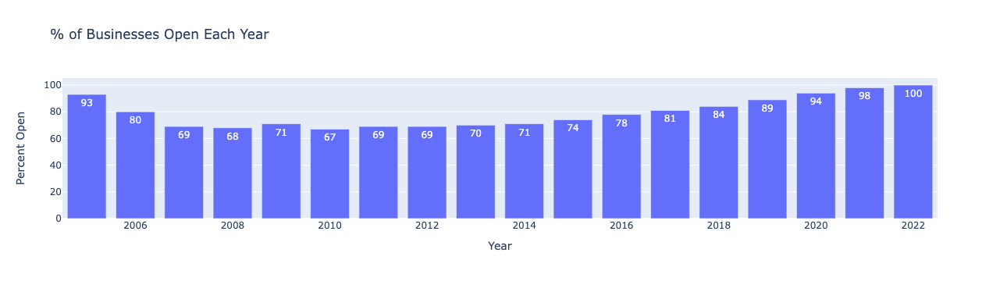

In [108]:
# Plot the percent of open businesses each yeard
fig = px.bar(open_year, x='Year', y='Percent Open', title='% of Businesses Open Each Year', text_auto = True)
fig.show()

<div class="alert alert-block alert-info">
    The percentage of businesses open declined from 2005 to 2008 and stayed relatively constantly through 2014. The percentage of businesses open has increased roughly 20-25% since 2018.
</div>

In [109]:
# Define a function to plot the number of businesses open by year for each state
def state_open_overtime(state):
    # Filter the reviews_df for the specific state
    df_state = df[df['state'] == state]
    
    # Create a dataframe of the percentage of businesses open each year
    open_year_state = pd.DataFrame((df_state.groupby('year')['is_open'].sum()/df_state.groupby('year')['is_open'].count()).round(2)*100)
    open_year_state = open_year_state.reset_index().rename(columns={'year': 'Year', 'is_open': 'Percent Open'})
    
    # Plot the percent of open businesses each yeard
    fig = px.bar(open_year_state, x='Year', y='Percent Open', title=f'% of Businesses Open Each Year in {state}', text_auto = True)
    fig.show()

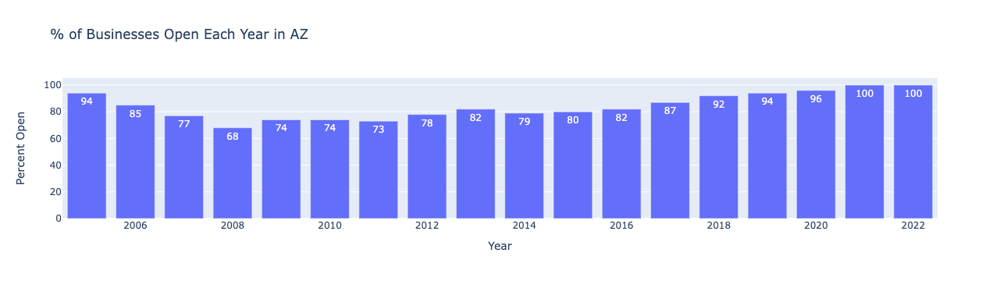

In [110]:
state_open_overtime('AZ')

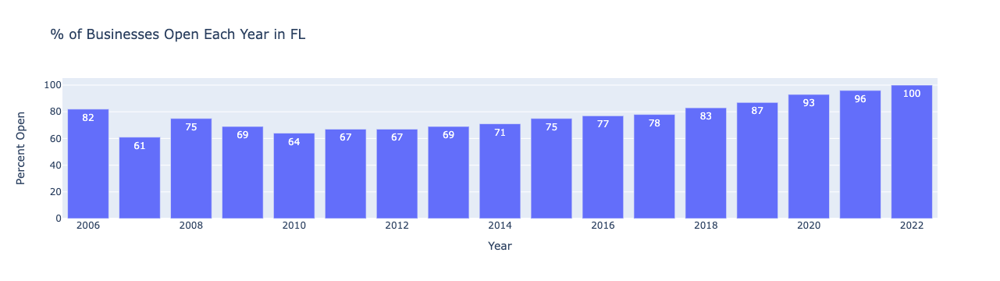

In [111]:
state_open_overtime('FL')

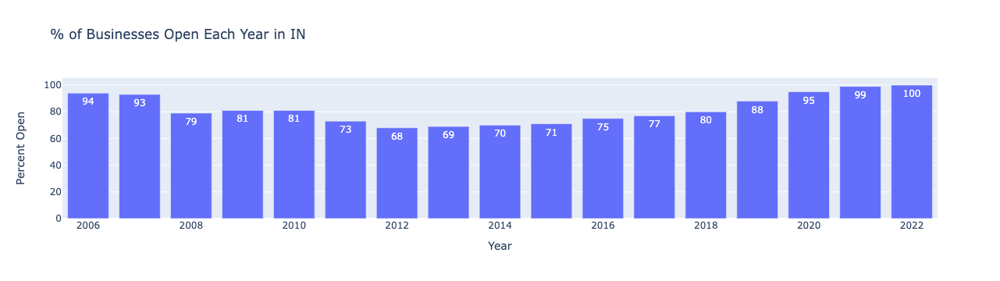

In [112]:
state_open_overtime('IN')

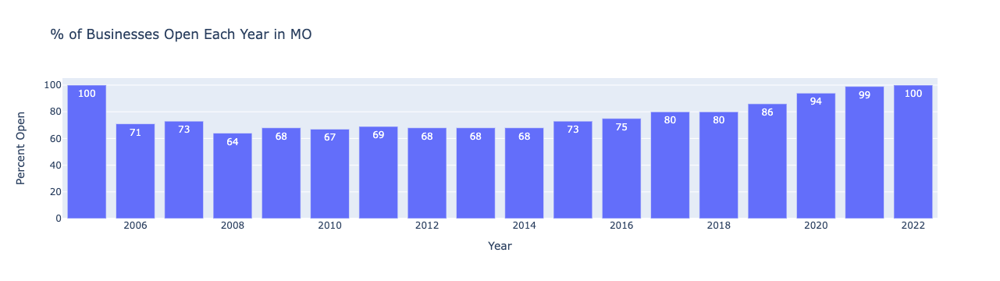

In [113]:
state_open_overtime('MO')

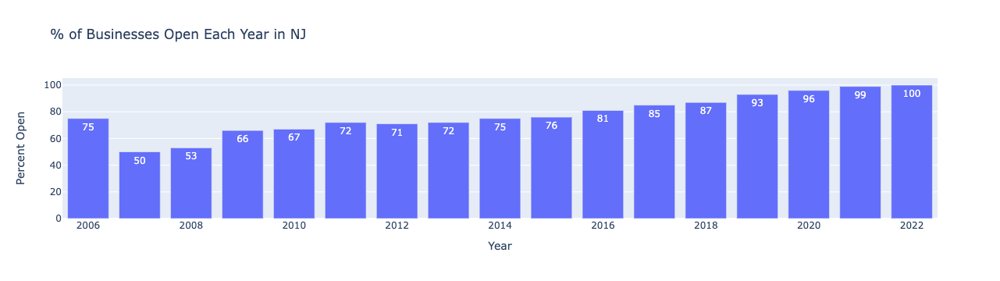

In [114]:
state_open_overtime('NJ')

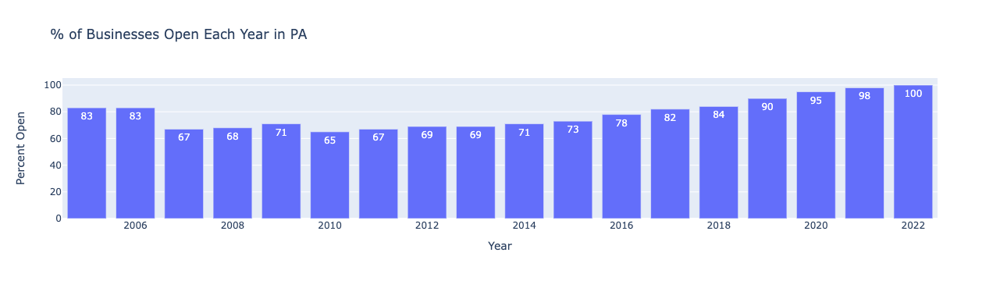

In [115]:
state_open_overtime('PA')

<div class="alert alert-block alert-info">
    There are no major differences by state over time.
</div>

#### Average Score by Year

In [116]:
# Create a dataframe of the average rating per year
rating_year = pd.DataFrame((df.groupby('year')['stars'].mean().round(2)))
rating_year = rating_year.reset_index().rename(columns={'year': 'Year', 'stars': 'Avg. Star Rating'})

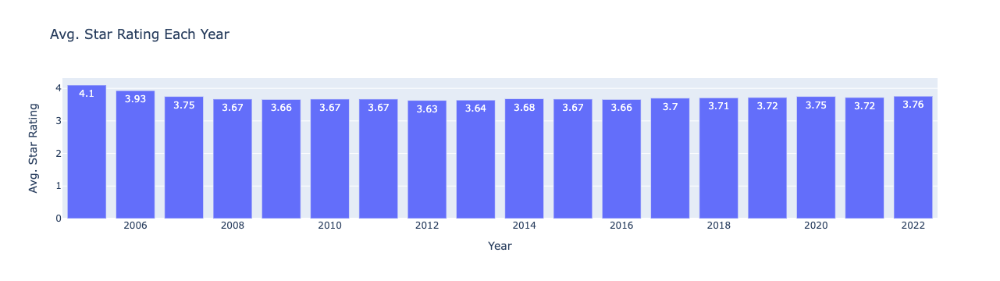

In [117]:
# Plt the average rating per year
fig = px.bar(rating_year, x='Year', y='Avg. Star Rating', title='Avg. Star Rating Each Year', text_auto = True)
fig.show()

<div class="alert alert-block alert-info">
    The average rating declined from 2005 through 2009 where it stayed relatively consistent through 2016. There was a slight increase in 2017 with the average star rating staying relatively consistent since then.
</div>

In [118]:
# Define a function to plot the average rating over time for each state
def state_rating_overtime(state):
    # Filter the reviews_df for the specific state
    df_state = df[df['state'] == state]
    
    # Create a dataframe of the average rating per year
    rating_year_state = pd.DataFrame((df_state.groupby('year')['stars'].mean().round(2)))
    rating_year_state = rating_year_state.reset_index().rename(columns={'year': 'Year', 'stars': 'Avg. Star Rating'})

    # Plt the average rating per year
    fig = px.bar(rating_year_state, x='Year', y='Avg. Star Rating', title=f'Avg. Star Rating Each Year in {state}', text_auto = True)
    fig.show()

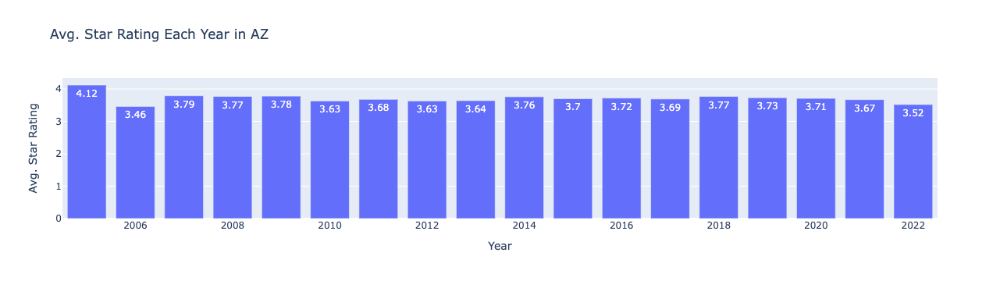

In [119]:
state_rating_overtime('AZ')

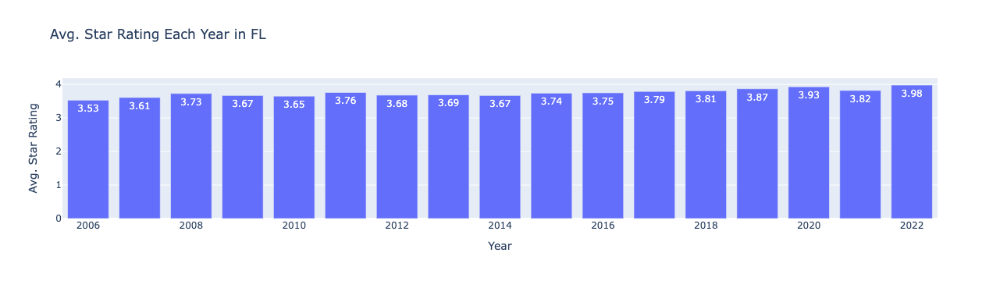

In [120]:
state_rating_overtime('FL')

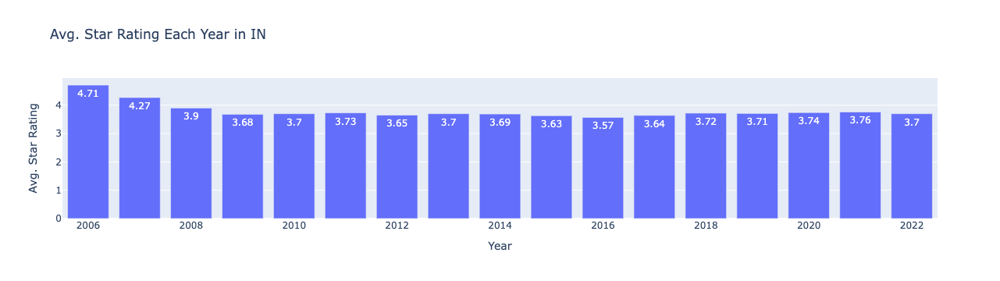

In [121]:
state_rating_overtime('IN')

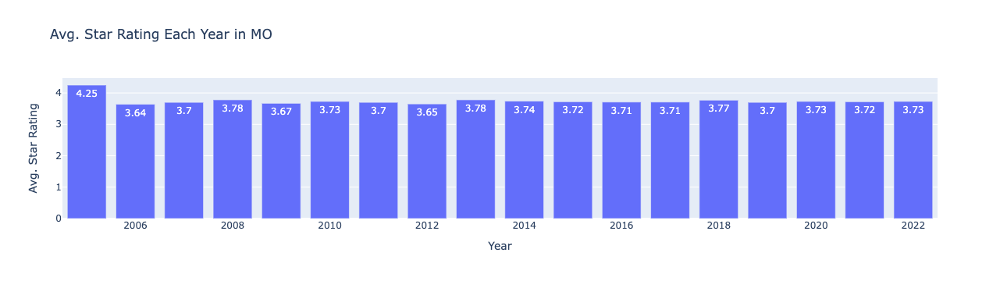

In [122]:
state_rating_overtime('MO')

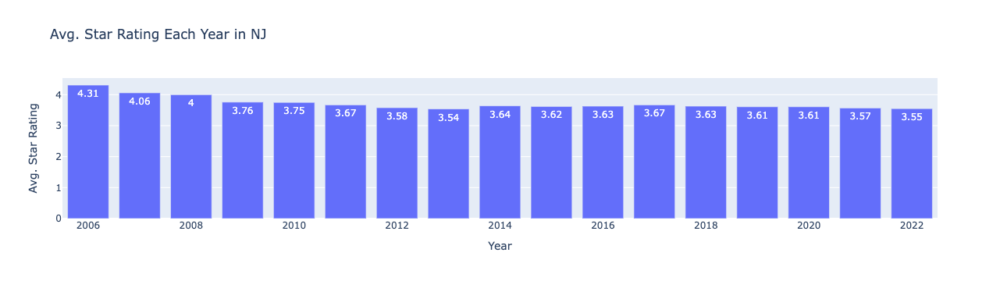

In [123]:
state_rating_overtime('NJ')

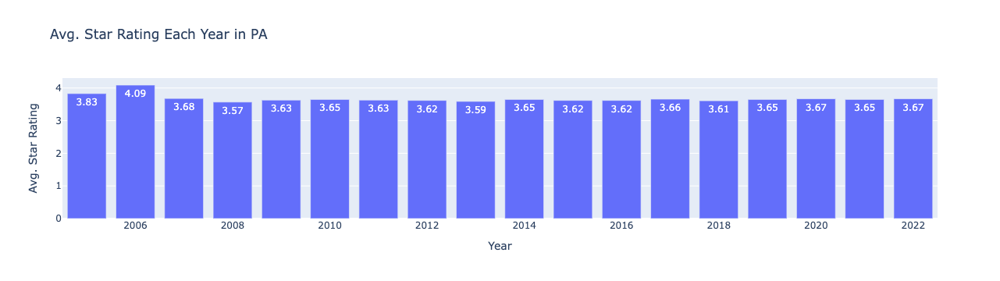

In [124]:
state_rating_overtime('PA')

<div class="alert alert-block alert-info">
    AZ and NJ have trended downward in the last couple years whereas FL has trended upward.
</div>

### Text Data

Adapting the steps from [AnalyticsVidhya](https://www.analyticsvidhya.com/blog/2021/06/text-preprocessing-in-nlp-with-python-codes/) and developing the word cloud from https://towardsdatascience.com/text-mining-and-sentiment-analysis-for-yelp-reviews-of-a-burger-chain-6d3bcfcab17b

#### Length of Comments

In [125]:
# Determine the average length of a review
df['text_length'] = df['text'].astype(str).map(len)

In [126]:
# Review summary statiticsfor text_length
pd.DataFrame(df['text_length'].describe())

,text_length
count,346149.000000
mean,512.581966
std,467.734876
min,1.000000
25%,210.000000
50%,368.000000
75%,650.000000
max,5000.000000


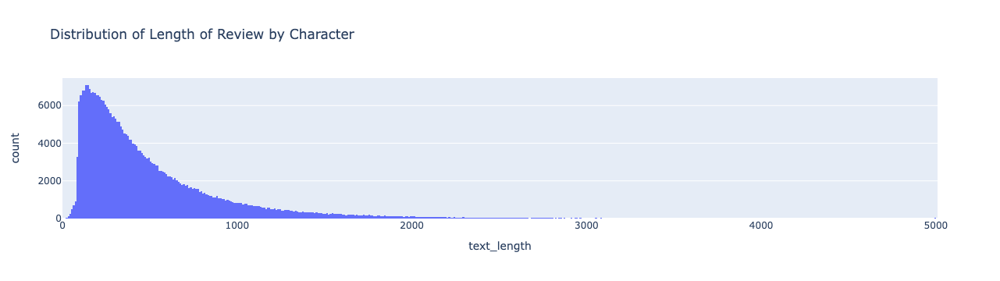

In [127]:
# Plot a histogram of the length of a comment
fig = px.histogram(df, x="text_length", title = 'Distribution of Length of Review by Character')
fig.show()

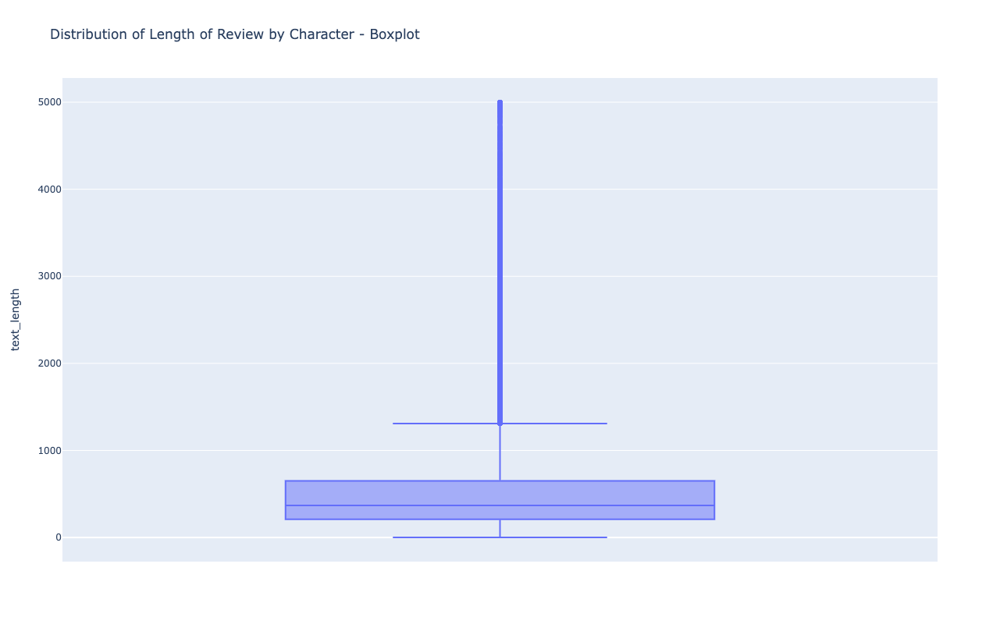

In [128]:
# Plot a boxplot for the length of comments
fig = px.box(df, y='text_length', title='Distribution of Length of Review by Character - Boxplot', width=800, height=800)
fig.show()

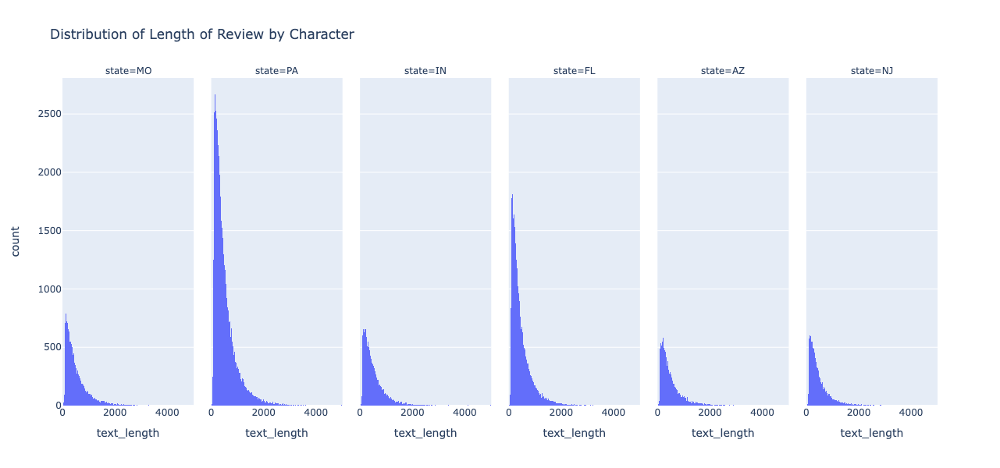

In [129]:
# Plot a histogram of the length of a comment by state
fig = px.histogram(df, x="text_length", title = 'Distribution of Length of Review by Character', facet_col = 'state', height = 600)
fig.show()

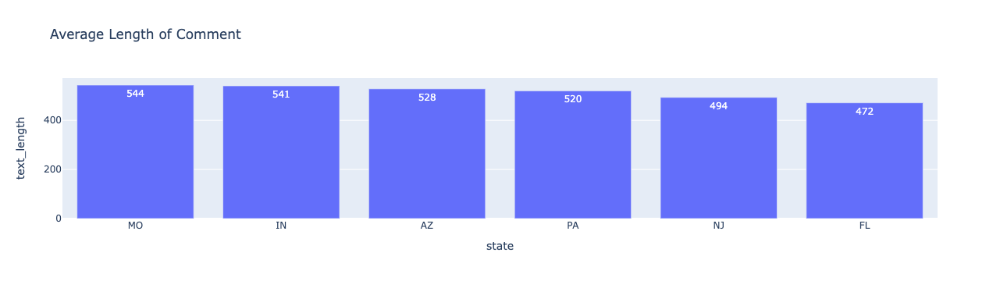

In [130]:
# Plot the average length of a comment by state
comment_length_state = pd.DataFrame(df.groupby('state')['text_length'].mean().reset_index().sort_values(by='text_length', ascending=False))
fig = px.bar(comment_length_state, x='state', y='text_length', title='Average Length of Comment', text_auto = '.3s')
fig.show()

<div class="alert alert-block alert-info">
    There is some variation in the length of comments by state. <b>Generally, the average review is about 500 words, however that is skewed by the very long comments. The median is 368.</b>
</div>

#### Deepdish References

In [138]:
# Add a column for deep dish
condition = [
    (df['text'].str.contains('deepdish')) | (df['text'].str.contains('deep dish'))
]

value = ['Yes']

df['deep_dish'] = np.select(condition, value, default='No')

In [142]:
# Identify which states have the most deep dish reviews
pd.DataFrame(df.groupby('deep_dish')['state'].value_counts())

state
deep_dish state        
No        PA     134407
          FL      76339
          MO      38218
          IN      35157
          NJ      28681
          AZ      28679
Yes       IN       1337
          MO       1261
          FL       1063
          AZ        490
          PA        432
          NJ         85

In [151]:
# Calculate the number of businesses in each state that have at least one deep dish restaurant
deepdish_df = df[df['deep_dish'] == 'Yes']
pd.DataFrame(deepdish_df.groupby('state')['business_id'].nunique().sort_values(ascending=False))

,business_id
state,
FL,187
PA,180
IN,137
MO,97
AZ,57
NJ,35


In [154]:
# Calculate the percent of businesses that mention deep dish pizza in their reviews by state
pd.DataFrame(round(deepdish_df.groupby('state')['business_id'].nunique()/df.groupby('state')['business_id'].nunique()*100).sort_values(ascending=False))

,business_id
state,
IN,23.0
AZ,22.0
MO,18.0
FL,17.0
PA,8.0
NJ,5.0


<div class="alert alert-block alert-info">
    Each state has pizza businesses that have comments about their deep dish pizza. IN, MO, and FL all have at least 1000 reviews while AZ, PA, and NJ all have fewer than 500. However, while PA has fewer reviews, they have far more businesses who have deep dish reviews. When considering the density of businesses that have reviews about their deep dish pizza, IN and AZ have the highest percentage. PA and NJ have the lowest percentages.
</div>

In [159]:
# Calculate the percent of reviews that mention deep dish pizza by state
pd.DataFrame(round(deepdish_df['state'].value_counts()/df['state'].value_counts()*100).sort_values(ascending=False))

,state
IN,4.0
MO,3.0
AZ,2.0
FL,1.0
NJ,0.0
PA,0.0


In [160]:
# Calculate the average review score that mentioned deep dish pizza
pd.DataFrame(deepdish_df.groupby('state')['stars'].mean().sort_values(ascending=False))

,stars
state,
MO,4.051546
AZ,4.026531
IN,3.938669
FL,3.892756
PA,3.828704
NJ,3.670588


In [186]:
# Calculate the difference in average review score from the deep dish and average review by state
pd.DataFrame(deepdish_df.groupby('state')['stars'].mean() - df.groupby('state')['stars'].mean())

,stars
state,
AZ,0.318759
FL,0.095245
IN,0.250419
MO,0.328098
NJ,0.047283
PA,0.193479


<div class="alert alert-block alert-info">
    For all states, the percentage of reviews about deep dish pizza that makes up the total number of reviews is small. However, the reviews that are about deep dish are always more positive. This is especially true in AZ, MO, and IN, where the deep dish reviews are at least a quarter-point more positive.
</div>

In [176]:
# Define a function for plotting the map with zoom based on points (with color for open or closed)
def plot_business_map_zoom_deepdish(state):
    # Get the appropriate shp file
    path = Path(f'../maps/{state}/')
    extension = '.shp'
    shp_file = next(path.glob(f'*{extension}'))
    state_map = gpd.read_file(f'{shp_file}')
    
    # Filter the business_df 
    filtered_df = df[df['state'] == f'{state}']
    
    # Create a feature of the latitude and longtitude
    gdf = gpd.GeoDataFrame(filtered_df, 
                           geometry = gpd.points_from_xy(filtered_df['longitude'], filtered_df['latitude']))
    
    # Plot the map with data points
    fig, ax = plt.subplots(figsize=(15,15))
    state_map.plot(ax=ax, alpha=0.8, color='white', edgecolor='black')
    gdf.plot(column='deep_dish', ax=ax, legend='True', alpha = 0.8)
    plt.title(f'Deepdish Pizza Business Locations - {state} (Zoomed)', fontsize=15, fontweight='bold')
    
    # Zoom in to show the distribution better
    minx, miny, maxx, maxy = gdf.total_bounds
    ax.set_xlim(minx-0.5, maxx+0.5)
    ax.set_ylim(miny-0.5, maxy+0.5)
    
    plt.show()

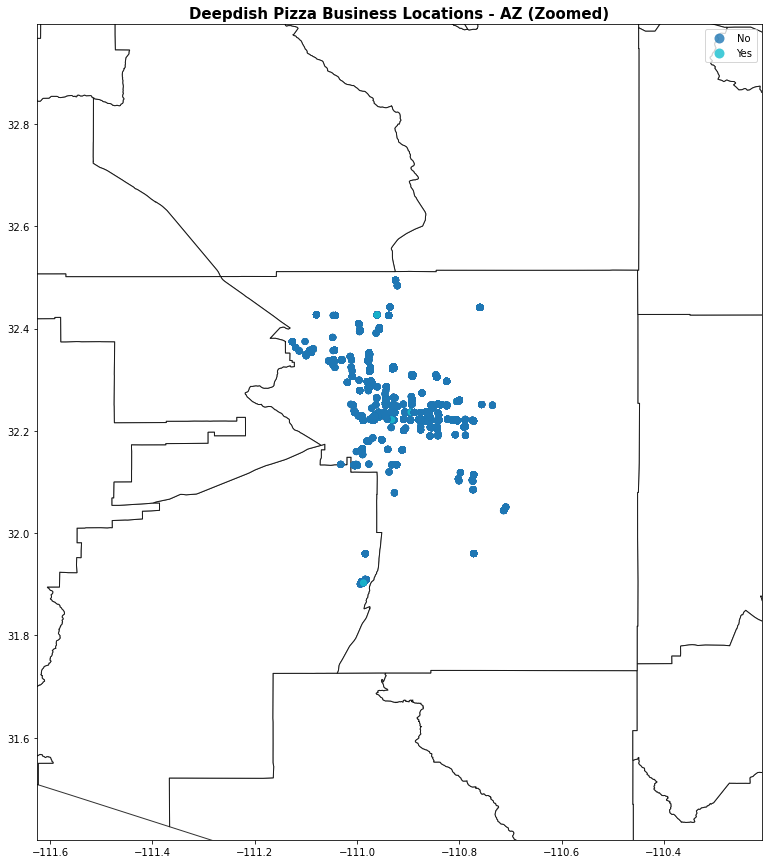

In [177]:
plot_business_map_zoom_deepdish('AZ')

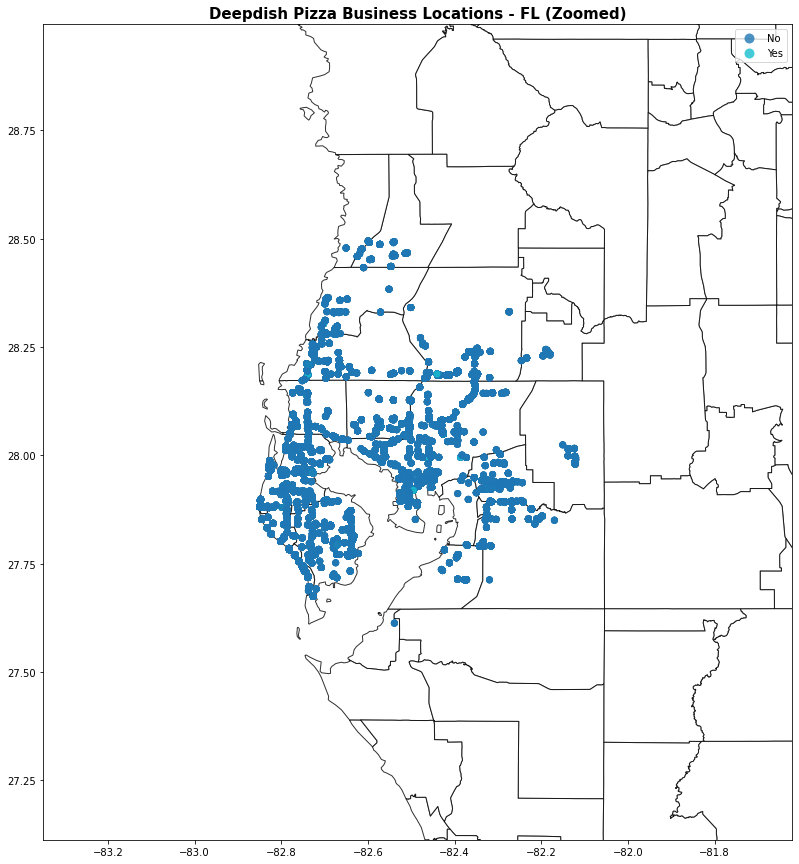

In [178]:
plot_business_map_zoom_deepdish('FL')

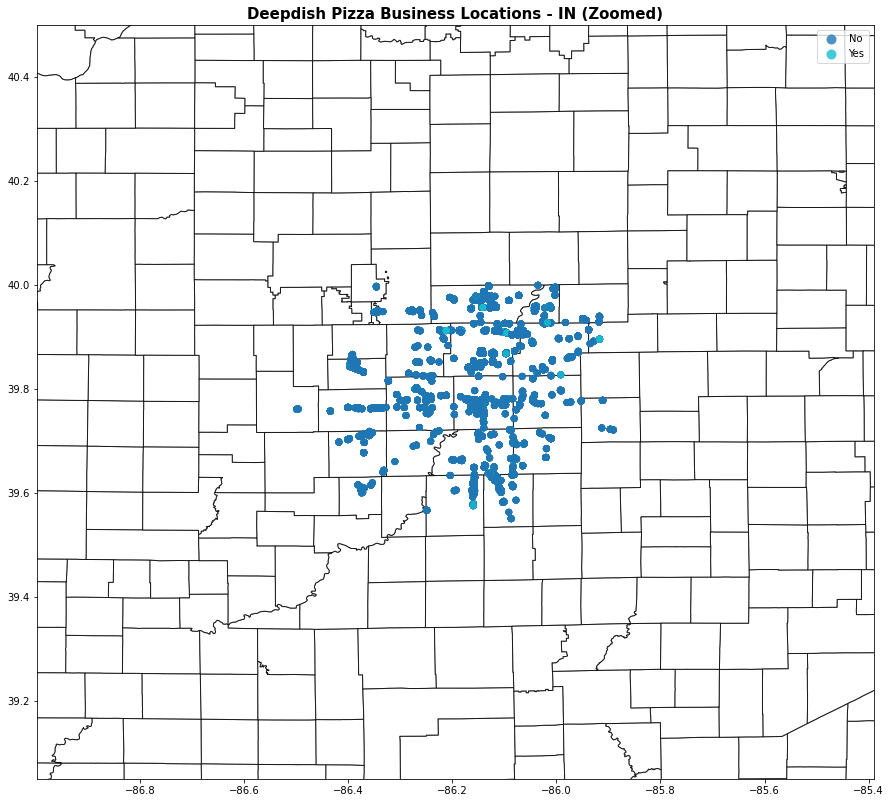

In [179]:
plot_business_map_zoom_deepdish('IN')

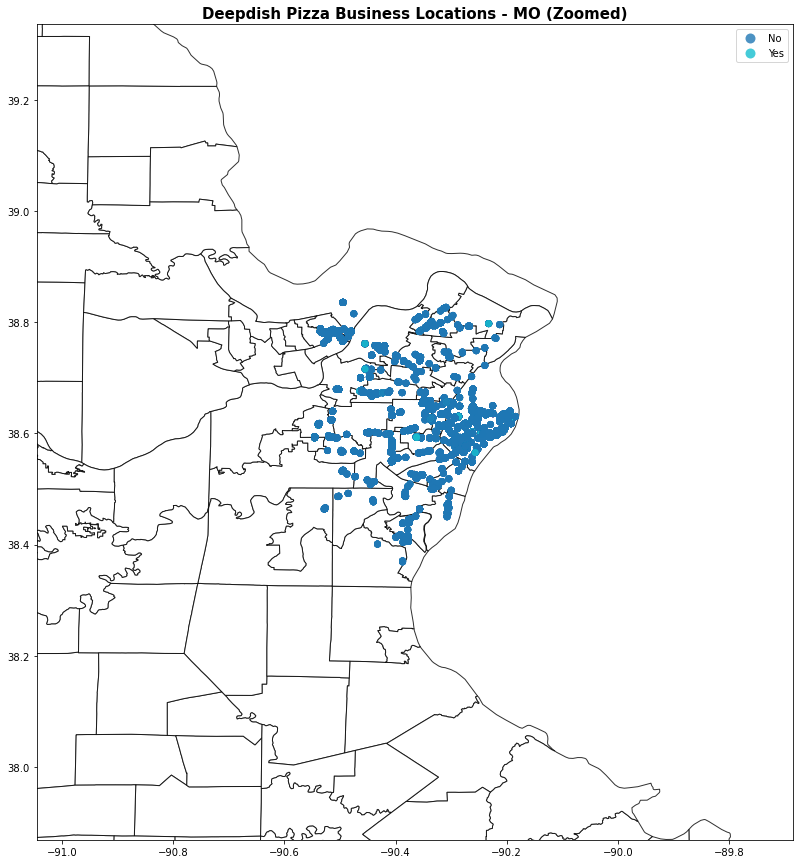

In [180]:
plot_business_map_zoom_deepdish('MO')

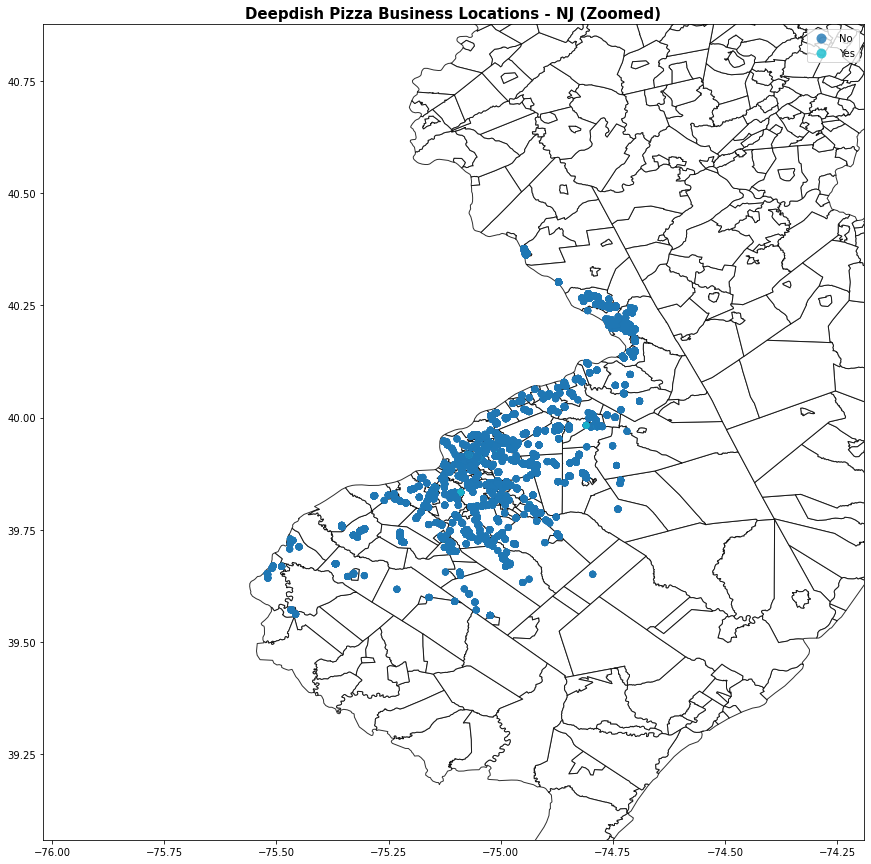

In [181]:
plot_business_map_zoom_deepdish('NJ')

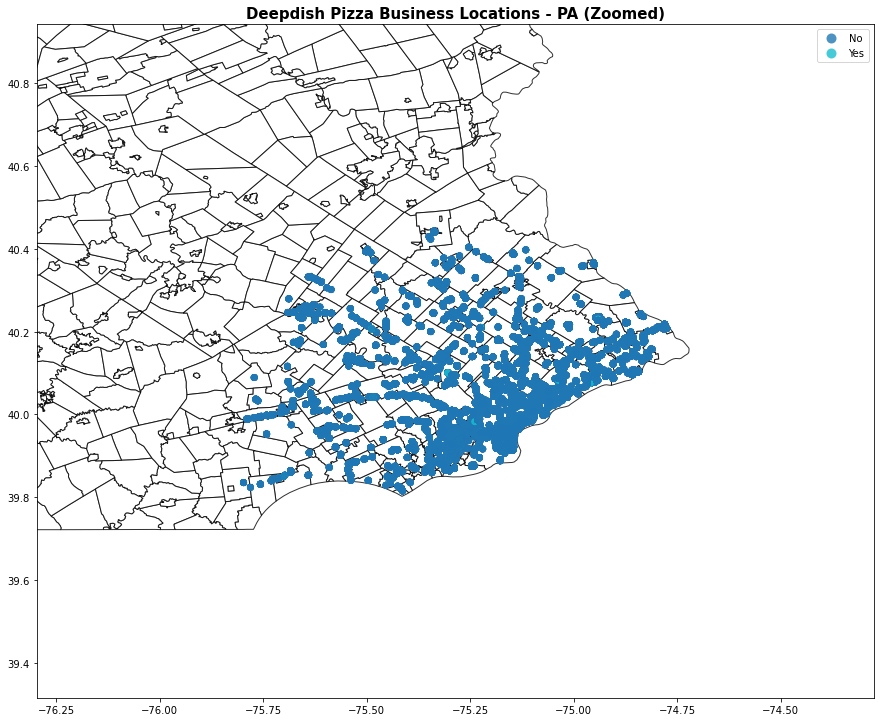

In [182]:
plot_business_map_zoom_deepdish('PA')

#### Process Text

In [192]:
# Filter the df to only show the reviews that contain deep dish
df = df[(df['text'].str.contains('deepdish')) | (df['text'].str.contains('deep dish'))]

In [193]:
# Define a function to remove punctuation
def remove_punctuation(text):
    punctuationfree = "".join([i for i in text if i not in string.punctuation])
    return punctuationfree

In [194]:
# Create a new feature with the clean data
df['text_clean']= df['text'].apply(lambda x:remove_punctuation(x))

In [195]:
# Lower the clean text
df['text_clean'] = df['text_clean'].apply(lambda x: x.lower())

In [196]:
# Create a new feature with tokenized clean data
df['text_clean'] = df['text_clean'].apply(lambda x: word_tokenize(x))

In [197]:
# Stopword filtering
stop_words = set(stopwords.words('english'))

In [198]:
# Define function to remove stopwords from tokenized text
def remove_stopwords(text):
    output= [i for i in text if i not in stop_words]
    return output

In [199]:
# Applying the remove_stopwords function
df['text_clean']= df['text_clean'].apply(lambda x:remove_stopwords(x))

In [200]:
# Define the object for stemming
porter_stemmer = PorterStemmer()

# Define a function for stemming
def stemming(text):
    stem_text = [porter_stemmer.stem(word) for word in text]
    return stem_text

df['text_stemmed'] = df['text_clean'].apply(lambda x: stemming(x))

In [201]:
# Define the object for Lemmatization
wordnet_lemmatizer = WordNetLemmatizer()

# Define a function for lemmatization
def lemmatizer(text):
    lemm_text = [wordnet_lemmatizer.lemmatize(word) for word in text]
    return lemm_text

df['text_lemmatized'] = df['text_clean'].apply(lambda x:lemmatizer(x))

In [202]:
# Determine the frequency of the words in the entire dataframe using the stemming process
fdist_stemmed = FreqDist(list(df['text_stemmed'].explode()))
df_fdist_stemmed = pd.DataFrame.from_dict(fdist_stemmed, orient='index')
df_fdist_stemmed.columns = ['Frequency']
df_fdist_stemmed.index.name = 'Term'
df_fdist_stemmed = df_fdist_stemmed.reset_index().sort_values(by='Frequency', ascending=False)

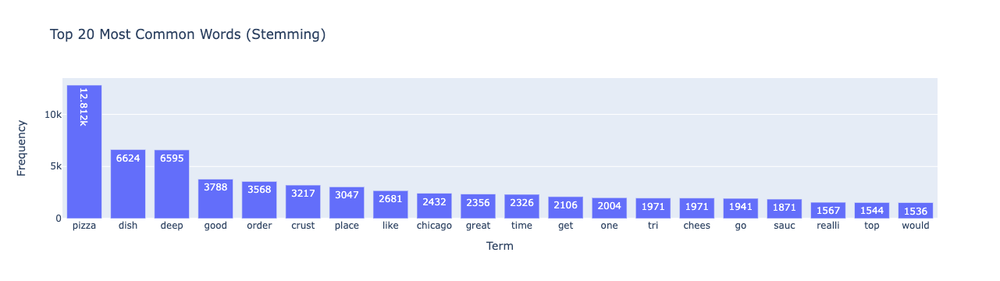

In [203]:
# Plot the most common words using stemming
fig = px.bar(df_fdist_stemmed.head(20), x='Term', y='Frequency', title='Top 20 Most Common Words (Stemming)', text_auto = True)
fig.show()

In [204]:
# Determine the frequency of the words in the entire dataframe using the lemmitization process
fdist_lemmatized = FreqDist(list(df['text_lemmatized'].explode()))
df_fdist_lemmatized = pd.DataFrame.from_dict(fdist_lemmatized, orient='index')
df_fdist_lemmatized.columns = ['Frequency']
df_fdist_lemmatized.index.name = 'Term'
df_fdist_lemmatized = df_fdist_lemmatized.reset_index().sort_values(by='Frequency', ascending=False)

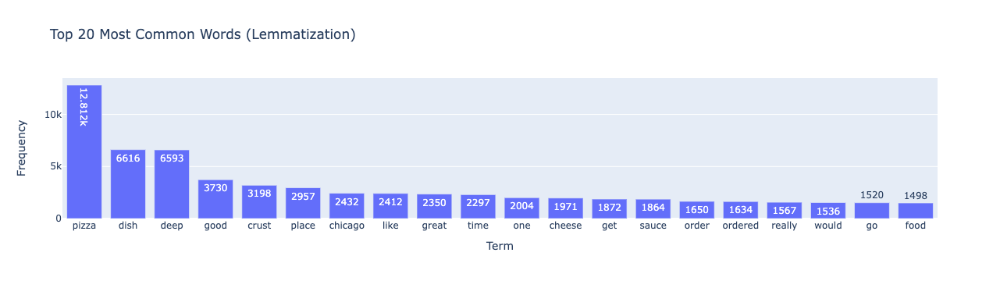

In [205]:
# Plot the most common words using lemmatization
fig = px.bar(df_fdist_lemmatized.head(20), x='Term', y='Frequency', title='Top 20 Most Common Words (Lemmatization)', text_auto = True)
fig.show()

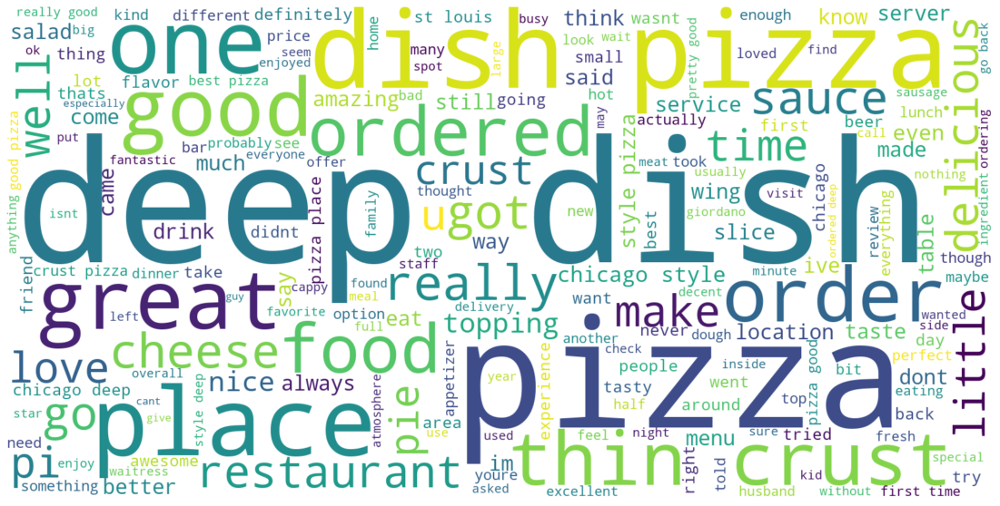

In [206]:
# Create a word cloud for all the lemmatized words
df['text_for_cloud_lemmatized'] = df['text_lemmatized'].apply(lambda x: ' '.join(x))
full_lemmatized = ' '.join(df['text_for_cloud_lemmatized'])
cloud_lemmatized = WordCloud(background_color='white', width=1600, height=800).generate(full_lemmatized)
plt.figure( figsize=(20,10))
plt.imshow(cloud_lemmatized, interpolation='bilinear')
plt.axis('off')
plt.show()

In [211]:
# Create a function to produce a word cloud for all the lemmatized words by state
def state_word_cloud(state):
    # Filter by state
    filtered_df = df[df['state'] == f'{state}'].copy()
    
    # Create word cloud
    filtered_df['text_for_cloud_lemmatized'] = filtered_df['text_lemmatized'].apply(lambda x: ' '.join(x))
    full_lemmatized = ' '.join(filtered_df['text_for_cloud_lemmatized'])
    cloud_lemmatized = WordCloud(background_color='white', width=1600, height=800).generate(full_lemmatized)
    plt.figure(figsize=(20,10))
    plt.imshow(cloud_lemmatized, interpolation='bilinear')
    plt.title(f'Deepdish Pizza Business Word Cloud - {state}', fontsize=15, fontweight='bold')
    plt.axis('off')
    plt.show()

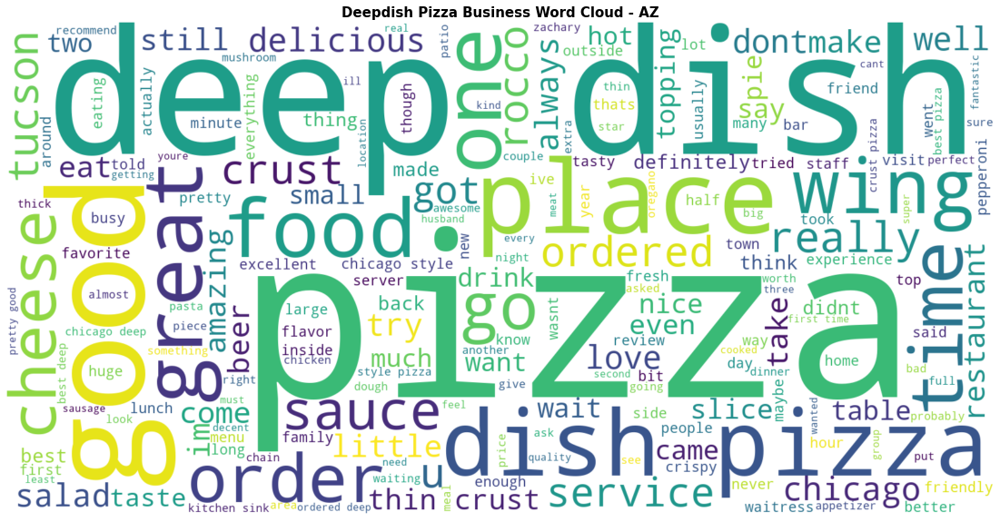

In [212]:
state_word_cloud('AZ')

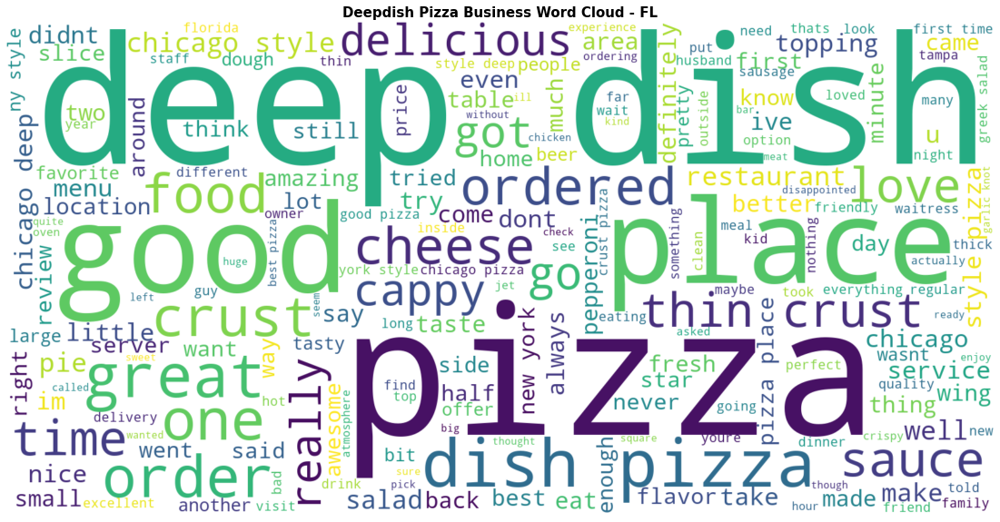

In [213]:
state_word_cloud('FL')

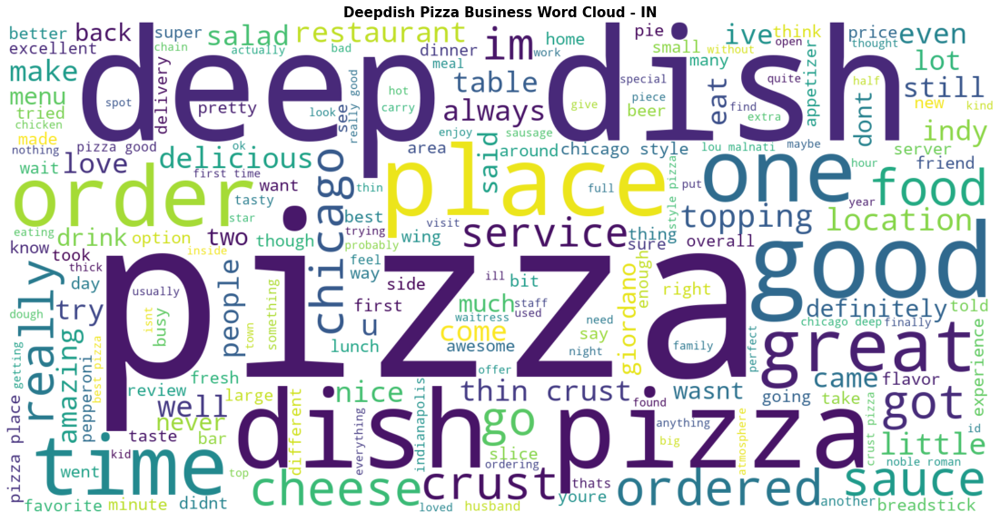

In [214]:
state_word_cloud('IN')

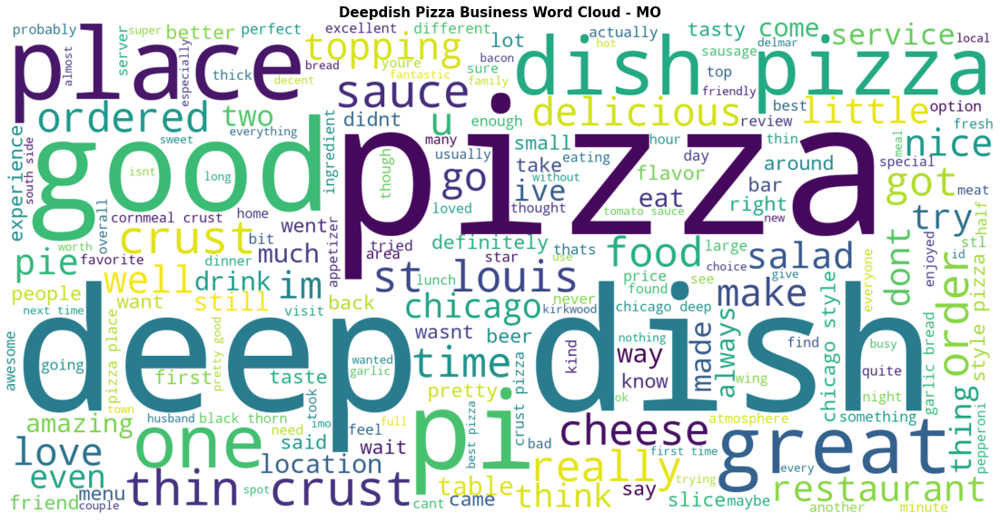

In [215]:
state_word_cloud('MO')

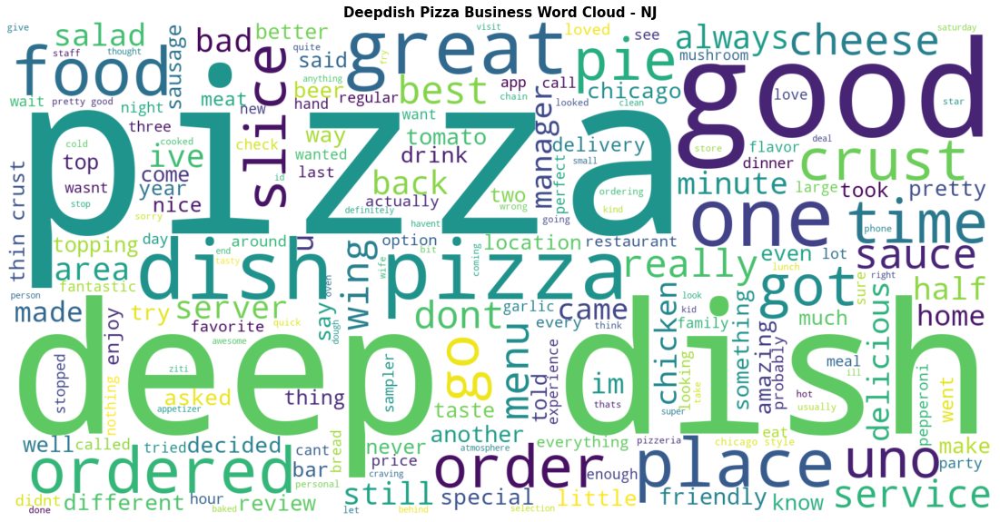

In [216]:
state_word_cloud('NJ')

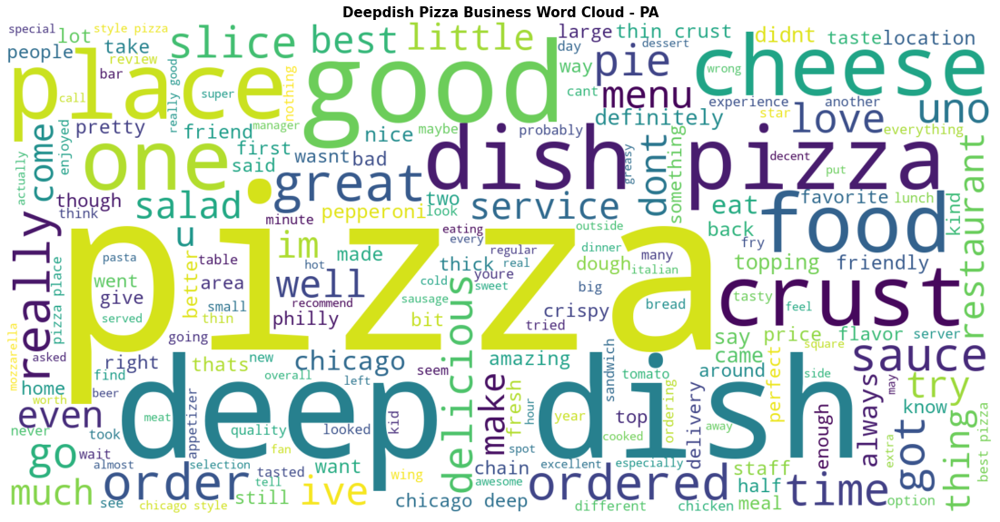

In [217]:
state_word_cloud('PA')

In [218]:
from sklearn.feature_extraction.text import CountVectorizer
vect = CountVectorizer(stop_words=stop_words, ngram_range=(2,2))
bigrams = vect.fit_transform(df['text'])
bigram_df = pd.DataFrame(bigrams.toarray(), columns=vect.get_feature_names())
bigram_frequency = pd.DataFrame(bigram_df.sum(axis=0)).reset_index()
bigram_frequency.columns = ['bigram', 'frequency']
bigram_frequency = bigram_frequency.sort_values(by='frequency', ascending=False).head(20)

In [219]:
bigram_frequency

,bigram,frequency
37824,deep dish,6516
42432,dish pizza,2096
156071,thin crust,1114
26355,chicago style,778
150476,style pizza,517
25987,chicago deep,470
146678,st louis,390
116853,pizza place,307
35201,crust pizza,302
150296,style deep,298


## Pickle the Dataframes
Keep only the original text and the stemmed text columns. Pickle the merged dataset

In [220]:
# Pickle the merged df
df.to_pickle(processed_df)  